<a href="https://colab.research.google.com/github/UgurUysal86/MLS4MIL/blob/master/MLS4MIL/Image%20Classification/code/RuTanks7000_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Ugur Uysal - ugur.uysal.86@gmail.com

### Experiments on COLAB with the Dataset from https://github.com/UgurUysal86/MLS4MIL/tree/master/Image%20Classification without the class "Civilian Car".

21.DEZ 2019

In [0]:
# Using tensorflow_version 1
%tensorflow_version 1.x
import tensorflow as tf
print("Using Tensorflow Version", tf.__version__, "\n")

# Validate COLAB GPU
from tensorflow.python.client import device_lib
for x in device_lib.list_local_devices():
   if x.device_type == "GPU":
     print("***** GPU Information *****")
     print("Device Name: " , x.name)
     print("Memory Limit: " , "%.2f" % float(x.memory_limit/(1000*1000*1000)), "GB")
     print("Description: " , x.physical_device_desc)

Using Tensorflow Version 1.15.0 

***** GPU Information *****
Device Name:  /device:GPU:0
Memory Limit:  15.96 GB
Description:  device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0


In [0]:
# Mounting Google Drive Files
from google.colab import drive
drive.mount('/content/gdrive',force_remount=True)
print ("Available files:")
!ls '/content/gdrive/My Drive/ColabExp/RuTanks7000_v2/dataset'

# Loading the dataset
import os
import zipfile
print ("Loading the Dataset RuTanks7000_v2.zip:")
local_zip = 'gdrive/My Drive/ColabExp/RuTanks7000_v2/dataset/RuTanks7000_v2.zip'
zip_ref = zipfile.ZipFile(local_zip, 'r')
zip_ref.extractall('/tmp')
zip_ref.close()
print ("Dataset RuTanks7000_v2.zip successfully loaded and unzipped")

# Settings paths
#path = '/tmp/'
dataset_path = '/tmp/' + 'RuTanks7000_v2/'
weights_path = 'gdrive/My Drive/ColabExp/RuTanks7000_v2/trained_models/weights_L1.h5'
model_path = 'gdrive/My Drive/ColabExp/RuTanks7000_v2/trained_models/RuTanks7000_v2_'
TensorBoardLogDir = 'gdrive/My Drive/ColabExp/RuTanks7000_v2/logs/'

Mounted at /content/gdrive
Available files:
RuTanks7000_v2.zip
Loading the Dataset RuTanks7000_v2.zip:
Dataset RuTanks7000_v2.zip successfully loaded and unzipped


In [0]:
# Setting Parameters #####
img_height,img_width = 331, 331  # For NASNetLarge

classnames = ["Background", "BMP2", "Buk-M1-2", "T14", "T90", "ZSU23"]

nbrTrainImages = 7000  # per class
nbrTestImages = 0  # Value gets accurate after counting (Total Number of test images)
for ImagesClass in os.listdir(dataset_path+'test/'):
    nbrTestImages += len(os.listdir(dataset_path+'test/'+ImagesClass))

# unfreezing the base network up to a specific layer in Level2:
freezeUptoLayer = "normal_add_1_15"   # NASNetLarge

# hyperparameters
learning_rate = 0.00025  # Learning_rate in Level 2 = learning_rate/10
lr_decay = 0.00005
batch = 196
fcLayer1 = 32
dropout = 0.5

epochsL1 = 10
patiencel1 = 3
factorL1 = 0.5

epochsL2 = 10
patiencel2 = 3
factorL2 = 0.5

verbose_train = 1
print("Training parameters set")

Training parameters set


In [0]:
# Datagenerators https://keras.io/preprocessing/image/
from keras.preprocessing.image import ImageDataGenerator
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=30,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    fill_mode='nearest',
    horizontal_flip=True)
train_generator = train_datagen.flow_from_directory(
    dataset_path+'train',
    target_size=(img_height, img_width),
    batch_size=batch,
    shuffle=True,
    classes=classnames,
    class_mode='categorical')

test_datagen = ImageDataGenerator(rescale=1./255)
test_generator = test_datagen.flow_from_directory(
    dataset_path+'test',
    target_size=(img_height, img_width),
    batch_size=1,
    shuffle=False,
    classes=classnames,
    class_mode='categorical')

Using TensorFlow backend.


Found 42000 images belonging to 6 classes.
Found 90 images belonging to 6 classes.


In [0]:
# function to plot results of model performance
import numpy as np
import matplotlib.pyplot as plt
def plot(h,t,e):
    history_dict = h[0]
    loss_values = history_dict['loss']
    validation_loss_values = history_dict['val_loss']
    acc_values = history_dict['acc']
    validation_acc_values = history_dict['val_acc']
    epochs_range = range(1, e + 1)

    # Plotting Training and Validation loss of the corresponding Model
    plt.plot(epochs_range, loss_values, 'bo', label='Training loss')
    plt.plot(epochs_range, validation_loss_values, 'ro', label='Validation loss')
    plt.title('Training and validation loss of ' + t)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.yticks(np.arange(0, 3.1, step=0.2))
    plt.legend()
    plt.show()

    # Plotting Training and Validation accuracy of the corresponding Model
    plt.plot(epochs_range, acc_values, 'bo', label='Training accuracy')
    plt.plot(epochs_range, validation_acc_values, 'ro', label='Validation accuracy')
    plt.title('Training and validation accuracy of ' + t)
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.yticks(np.arange(0.3, 1.1, step=0.1))
    plt.legend()
    plt.show()
print("plot function ready")

plot function ready


# Training the model with Transfer Learning

In [0]:
# using the pretrained model NASNetLarge as conv_base
from keras.applications import NASNetLarge
conv_base = NASNetLarge(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))
conv_base.summary()















Model: "NASNet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 331, 331, 3)  0                                            
__________________________________________________________________________________________________
stem_conv1 (Conv2D)             (None, 165, 165, 96) 2592        input_1[0][0]                    
__________________________________________________________________________________________________
stem_bn1 (BatchNormalization)   (None, 165, 165, 96) 384         stem_conv1[0][0]                 
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 165, 165, 96) 0           stem_bn1[0][0]                   
_______________________________________________________________________________

Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
trainable layers bevor freezing: 510
trainable layers after freezing: 2

pretrained network + densely connected classifier
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
NASNet (Model)               (None, 11, 11, 4032)      84916818  
_________________________________________________________________
global_average_pooling2d_1 ( (None, 4032)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 32)                129056    
_________________________________________________________________
dropout_1 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 6)                 198       
Total params: 

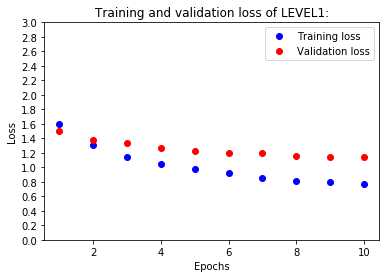

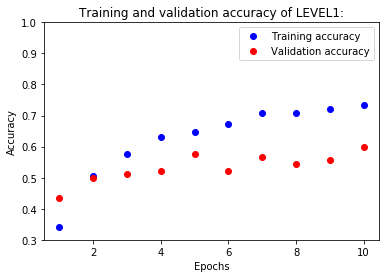


### LEVEL1 Training finished successfully ###


<function tensorflow.python.framework.ops.reset_default_graph>

In [0]:
# Imports for Transfer Learning with the Dataset
from keras import models, layers, optimizers, backend
from keras.models import load_model
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, TensorBoard
from timeit import default_timer as timer

# LEVEL1 - Training of added densely connected layers only
start = timer()

# Building the model using the pretrained model
model = models.Sequential()
model.add(conv_base)
model.add(layers.GlobalAveragePooling2D())
model.add(layers.Dense(fcLayer1, activation='relu'))
model.add(layers.Dropout(dropout))
model.add(layers.Dense(len(classnames), activation='softmax'))

# freezing the base network
print("trainable layers bevor freezing:", int(len(model.trainable_weights)/2)) # weights = weights + bias = 2 pro layer
conv_base.trainable = False
print("trainable layers after freezing:", int(len(model.trainable_weights)/2))
print("\npretrained network + densely connected classifier")
model.summary()

# training the added layers only
model.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=learning_rate, decay=lr_decay), metrics=['acc'])

callbacks_list_L1 = [ModelCheckpoint(filepath=weights_path, save_weights_only=True, monitor='val_acc', verbose=1, save_best_only=True),
                  ReduceLROnPlateau(monitor='val_acc', factor=factorL1, patience=patiencel1, verbose=1),
                  TensorBoard(log_dir=TensorBoardLogDir+'\\level1')]

print("\n### Level1 Training ... ")
# training the model
history = model.fit_generator(
    train_generator,
    steps_per_epoch=(nbrTrainImages * len(classnames)) // (batch * 10),
    epochs=epochsL1,
    callbacks=callbacks_list_L1,
    validation_data=test_generator,
    validation_steps=nbrTestImages,
    verbose=verbose_train)

history_val1 = [history.history]  # saving all results of the final test
plot(history_val1, "LEVEL1:", epochsL1)
print("\n### LEVEL1 Training finished successfully ###")

# Destroying the current TF graph - https://keras.io/backend/
tf.compat.v1.reset_default_graph


### LEVEL2 ###

Loading best trained weights of LEVEL 1 from gdrive/My Drive/ColabExp/RuTanks7000_v2/trained_models/weights_L1.h5 ...

trainable layers before unfreezing the base network up to normal_add_1_15:  510
trainable layers after the base network unfreezed from layer normal_add_1_15:  71

LEVEL2 Model after unfreezing the base network
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
NASNet (Model)               (None, 11, 11, 4032)      84916818  
_________________________________________________________________
global_average_pooling2d_2 ( (None, 4032)              0         
_________________________________________________________________
dense_3 (Dense)              (None, 32)                129056    
_________________________________________________________________
dropout_2 (Dropout)          (None, 32)                0         
______________________________________

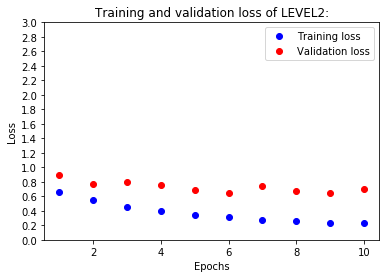

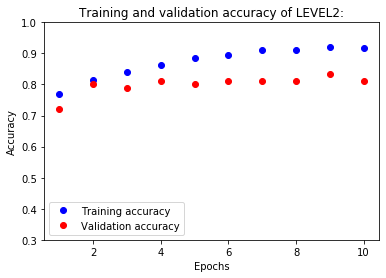


###LEVEL2 Training finished successfully ###


In [0]:
# LEVEL2 - Training the pretrained model + the trained classifier from level 1
from keras.applications import NASNetLarge
from keras import models, layers, optimizers, backend
from keras.models import load_model
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, TensorBoard
from timeit import default_timer as timer

# Resetting the conv_base
conv_base = NASNetLarge(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))

print("\n### LEVEL2 ###")
model2 = models.Sequential()
model2.add(conv_base)
model2.add(layers.GlobalAveragePooling2D())
model2.add(layers.Dense(fcLayer1, activation='relu'))
model2.add(layers.Dropout(dropout))
model2.add(layers.Dense(len(classnames), activation='softmax'))

print("\nLoading best trained weights of LEVEL 1 from " + weights_path + " ...")
model2.load_weights(weights_path)

# unfreezing the base network up to a specific layer:
if freezeUptoLayer == "":
    conv_base.trainable = True
    print ("\ntrainable layers: ",int(len(model2.trainable_weights) / 2))
else:
    print("\ntrainable layers before unfreezing the base network up to " + freezeUptoLayer + ": ",int(len(model2.trainable_weights) / 2))  # weights = weights + bias = 2 pro layer
    conv_base.trainable = True
    set_trainable = False
    for layer in conv_base.layers:
        if layer.name == freezeUptoLayer: set_trainable = True
        if set_trainable: layer.trainable = True
        else: layer.trainable = False
    print("trainable layers after the base network unfreezed from layer " + freezeUptoLayer + ": ", int(len(model2.trainable_weights)/2))

print("\nLEVEL2 Model after unfreezing the base network")
model2.summary()
model2.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=learning_rate/10, decay=lr_decay), metrics=['acc'])
print ("\n### Validating ... ")

val_loss, val_acc = model2.evaluate_generator(test_generator, steps=nbrTestImages, verbose=0)
print('Validation Results before training unfreeze layers and trained densely connected layers:\nValidation loss:',val_loss,",",'Validation accuracy:', val_acc, "\n")

# Jointly training both the unfreeze layers and the added trained densely connected layers
callbacks_list_L2 = [ModelCheckpoint(filepath=model_path+'l2.h5', save_weights_only=False, monitor='val_acc', verbose=1, save_best_only=True),
                  ReduceLROnPlateau(monitor='val_acc', factor=factorL2, patience=patiencel2, verbose=1),
                  TensorBoard(log_dir=TensorBoardLogDir+'\\level2')]

print ("\n### Level2 Training ... ")
history = model2.fit_generator(
    train_generator,
    steps_per_epoch=(nbrTrainImages * len(classnames)) // (batch * 10),
    epochs=epochsL2,
    callbacks=callbacks_list_L2,
    validation_data=test_generator,
    validation_steps=nbrTestImages,
    verbose=verbose_train)

history_val2 = [history.history]  # saving all results of the final test
plot(history_val2, "LEVEL2:", epochsL2)
print("\n###LEVEL2 Training finished successfully ###")

end = timer()
#print("Time elapsed in minutes: ", ((end - start)/60))

# Analyzing the trained model:

In [0]:
# Saving Test Images from Analysis Test Generator
test_images = []
for i in range(nbrTestImages):
    test_images.append(test_generator.next()[0][0])

test_images_path = []
true_labels = []
true_labels_class = []

test_images_Background = os.listdir(dataset_path +'test/Background/')
for imagefile in test_images_Background:
    test_images_path.append(dataset_path +'test/Background/' + imagefile)
    true_labels.append(0)
    true_labels_class.append('Background')

test_images_BMP2 = os.listdir(dataset_path +'test/BMP2/')
for imagefile in test_images_BMP2:
    test_images_path.append(dataset_path +'test/BMP2/' + imagefile)
    true_labels.append(1)
    true_labels_class.append('BMP2')

test_images_Buk = os.listdir(dataset_path +'test/Buk-M1-2/')
for imagefile in test_images_Buk:
    test_images_path.append(dataset_path +'test/Buk-M1-2/' + imagefile)
    true_labels.append(2)
    true_labels_class.append('Buk-M1-2')

test_images_T14 = os.listdir(dataset_path +'test/T14/')
for imagefile in test_images_T14:
    test_images_path.append(dataset_path +'test/T14/' + imagefile)
    true_labels.append(3)
    true_labels_class.append('T14')

test_images_T90 = os.listdir(dataset_path +'test/T90/')
for imagefile in test_images_T90:
    test_images_path.append(dataset_path +'test/T90/' + imagefile)
    true_labels.append(4)
    true_labels_class.append('T90')

test_images_ZSU23 = os.listdir(dataset_path +'test/ZSU23/')
for imagefile in test_images_ZSU23:
    test_images_path.append(dataset_path +'test/ZSU23/' + imagefile)
    true_labels.append(5)
    true_labels_class.append('ZSU23')

print(len(test_images), "test images successfully saved")

90 test images successfully saved


In [0]:
# Loading the trained model
print("Loading the best trained model of LEVEL 2 from " + model_path+"l2.h5" + " ...\n")
model = models.load_model(model_path+"l2.h5")
print("\nTrained model " + model_path+"l2.h5" + ":")
model.summary()

# predicting labels
pred = model.predict_generator(test_generator, nbrTestImages)
print("Dataset at", dataset_path +'test/', "has", pred.shape[0], "images with", pred.shape[1], "class predictions each")

Loading the best trained model of LEVEL 2 from gdrive/My Drive/ColabExp/RuTanks7000_v2/trained_models/RuTanks7000_v2_l2.h5 ...


Trained model gdrive/My Drive/ColabExp/RuTanks7000_v2/trained_models/RuTanks7000_v2_l2.h5:
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
NASNet (Model)               (None, 11, 11, 4032)      84916818  
_________________________________________________________________
global_average_pooling2d_2 ( (None, 4032)              0         
_________________________________________________________________
dense_3 (Dense)              (None, 32)                129056    
_________________________________________________________________
dropout_2 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_4 (Dense)              (None, 6)                 198       
Total params: 85,046,072
Trainab


### Testing the loaded model ... 
90/90 [==============================] - 20s 220ms/step
Test Results of the trained Model:
Test loss: 0.6516871972374955 , test accuracy: 0.8333333333333334

Confusion Matrix
[[15  0  0  0  0  0]
 [ 1 12  1  1  0  0]
 [ 0  0 15  0  0  0]
 [ 0  2  2  9  0  2]
 [ 0  0  0  1 14  0]
 [ 0  1  4  0  0 10]]

Classification Report
              precision    recall  f1-score   support

  Background       0.94      1.00      0.97        15
        BMP2       0.80      0.80      0.80        15
    Buk-M1-2       0.68      1.00      0.81        15
         T14       0.82      0.60      0.69        15
         T90       1.00      0.93      0.97        15
       ZSU23       0.83      0.67      0.74        15

    accuracy                           0.83        90
   macro avg       0.85      0.83      0.83        90
weighted avg       0.85      0.83      0.83        90



/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:29: UserWarning: Update your `Model` call to the Keras 2 API: `Model(outputs=[<tf.Tenso..., inputs=Tensor("NA...)`


img_tensors_array.shape= (90, 331, 331, 3)
activations.shape= (90, 6)


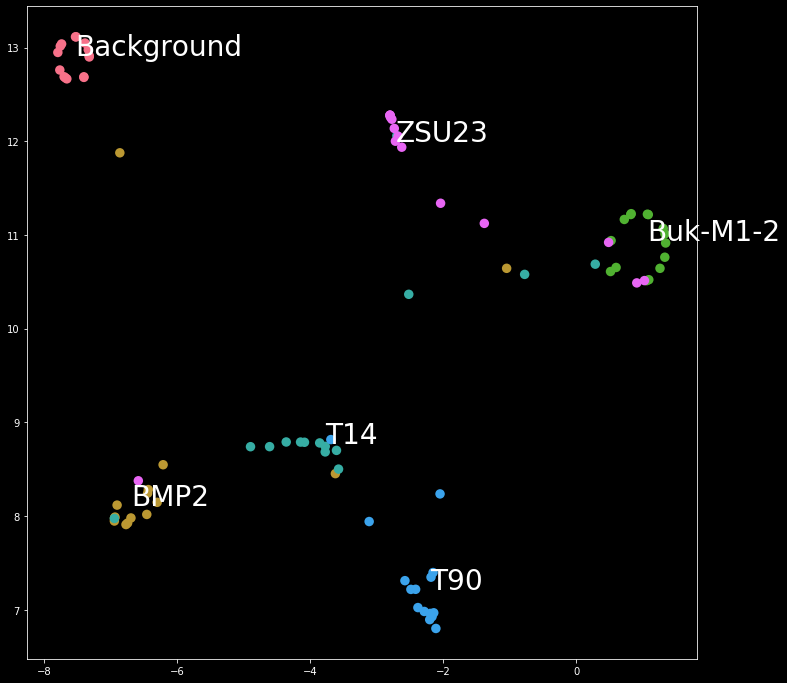

In [0]:
# analysing the model
from keras.preprocessing import image
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.manifold import TSNE
import seaborn as sns

print("\n### Testing the loaded model ... ")
test_loss, test_acc = model.evaluate_generator(test_generator, steps=nbrTestImages, verbose=1)
print('Test Results of the trained Model:\nTest loss:', test_loss, ",", 'test accuracy:', test_acc)

# Confusion Matrix and Classification Report
pred_argmax = np.argmax(pred, axis=1)
print('\nConfusion Matrix')
print(confusion_matrix(test_generator.classes, pred_argmax))
print('\nClassification Report')
print(classification_report(test_generator.classes, pred_argmax, target_names=classnames))

# t-SNE Visualization: t-Distributed Stochastic Neighbor Embedding (t-SNE) for visualizing high-dimensional data.
img_tensors = []
for i in range(len(test_images)):
    pred_img = image.load_img(test_images_path[i], target_size=(331, 331))
    img_tensor = image.img_to_array(pred_img)
    img_tensor = np.expand_dims(img_tensor, axis=0)
    img_tensor /= 255.
    img_tensors.append(img_tensor)

# Last conv layer
layer = model.layers[-1]
layer_output = layer.output
activation_model = models.Model(input=model.input, outputs=[layer_output])

img_tensors = np.asarray(img_tensors)
img_tensors_array = np.concatenate((img_tensors))
print("img_tensors_array.shape=", img_tensors_array.shape)

activations = activation_model.predict(img_tensors_array)
print("activations.shape=", activations.shape)

# calculating tsne #https://www.datacamp.com/community/tutorials/introduction-t-sne
tsne = TSNE(random_state=42).fit_transform(activations)

# Visualization of the feature vectors produce by the convnet
num_classes = len(classnames)
palette = np.array(sns.color_palette("husl", num_classes))
label_array = np.asarray(true_labels)

# create a scatter plot.
fig = plt.figure(figsize=(12, 12))
fig.patch.set_facecolor('black')
plt.style.use('dark_background')
plt.scatter(tsne[:, 0], tsne[:, 1], lw=0, s=90, c=palette[label_array])
plt.axis('tight')

txts = []
for j in range(num_classes):
    # Position of each label at median of data points.
    xtext, ytext = np.median(tsne[label_array == j, :], axis=0)
    txt = plt.text(xtext, ytext, classnames[j], fontsize=28, color = 'w')
    txts.append(txt)
plt.show()


Class Predictions of test images from /tmp/RuTanks7000_v2/test/
Image 1 : [(99.89, 'Background'), (0.04, 'T90'), (0.04, 'Buk-M1-2'), (0.01, 'T14'), (0.01, 'BMP2'), (0.0, 'ZSU23')] 



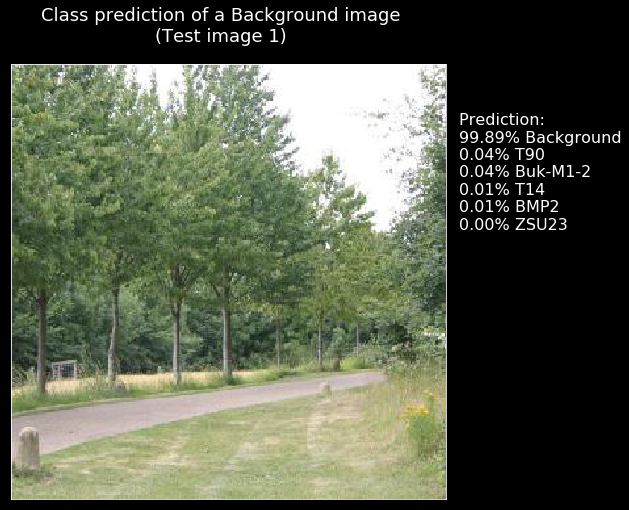

Image 2 : [(99.71, 'Background'), (0.11, 'BMP2'), (0.08, 'Buk-M1-2'), (0.06, 'T90'), (0.05, 'T14'), (0.0, 'ZSU23')] 



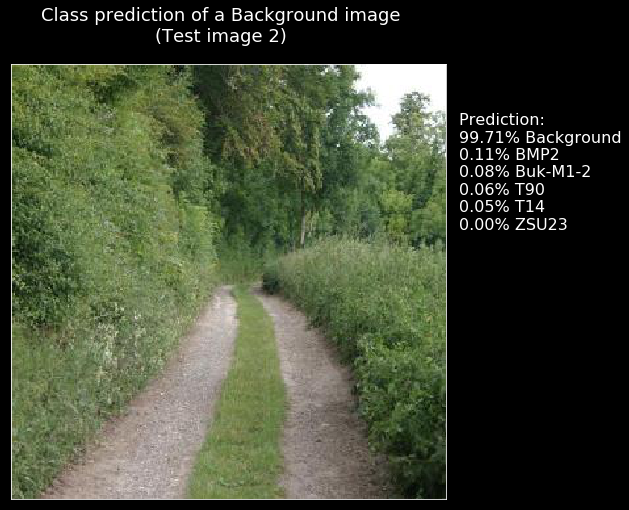

Image 3 : [(99.6, 'Background'), (0.25, 'Buk-M1-2'), (0.07, 'T90'), (0.05, 'BMP2'), (0.02, 'T14'), (0.01, 'ZSU23')] 



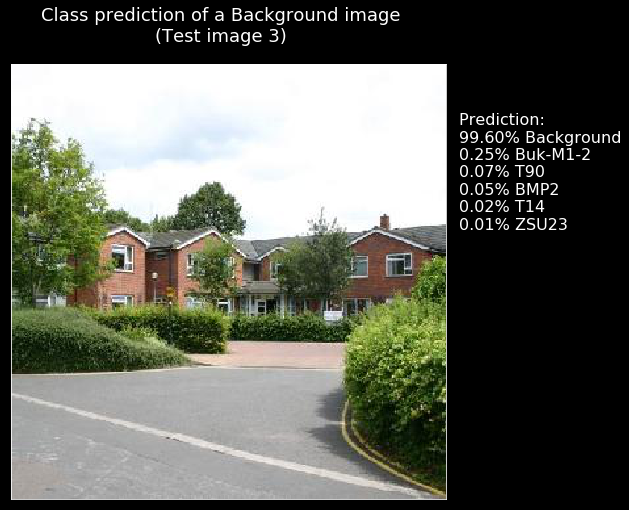

Image 4 : [(99.59, 'Background'), (0.35, 'T90'), (0.03, 'T14'), (0.03, 'Buk-M1-2'), (0.0, 'ZSU23'), (0.0, 'BMP2')] 



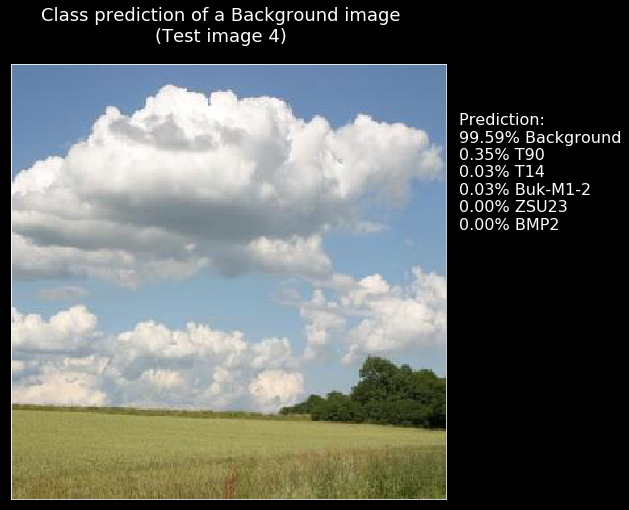

Image 5 : [(98.6, 'Background'), (0.72, 'Buk-M1-2'), (0.3, 'T90'), (0.28, 'BMP2'), (0.08, 'T14'), (0.03, 'ZSU23')] 



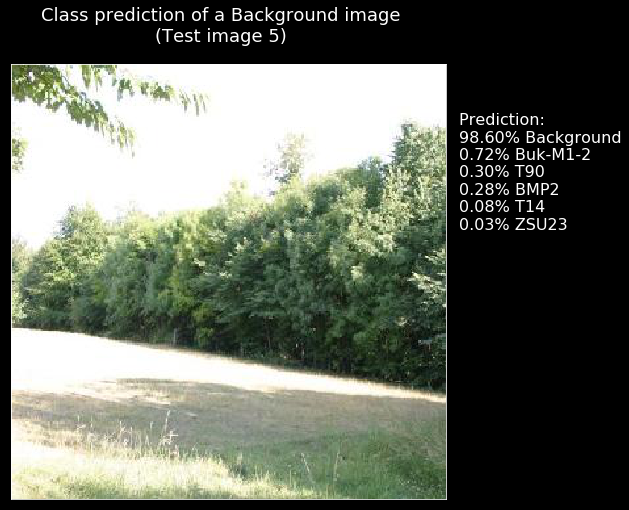

Image 6 : [(99.92, 'Background'), (0.04, 'BMP2'), (0.02, 'Buk-M1-2'), (0.01, 'T90'), (0.0, 'ZSU23'), (0.0, 'T14')] 



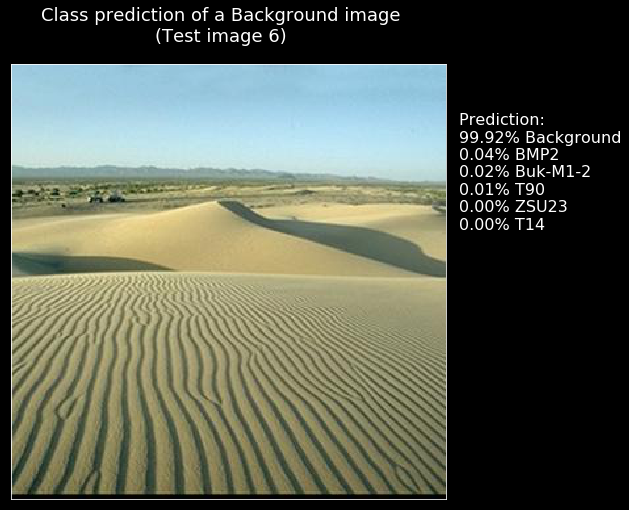

Image 7 : [(99.96, 'Background'), (0.02, 'T90'), (0.02, 'BMP2'), (0.01, 'Buk-M1-2'), (0.0, 'ZSU23'), (0.0, 'T14')] 



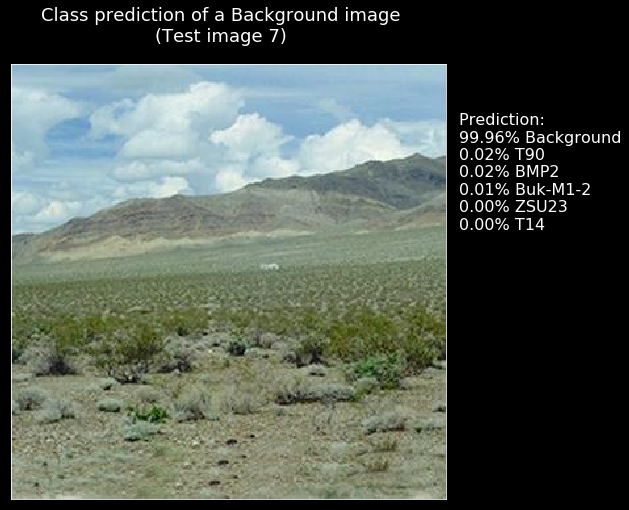

Image 8 : [(99.5, 'Background'), (0.3, 'T90'), (0.1, 'BMP2'), (0.07, 'T14'), (0.04, 'Buk-M1-2'), (0.0, 'ZSU23')] 



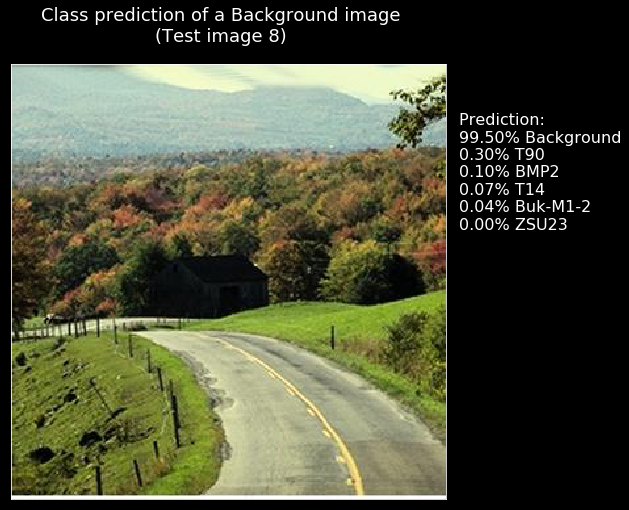

Image 9 : [(99.81, 'Background'), (0.1, 'T90'), (0.04, 'T14'), (0.04, 'Buk-M1-2'), (0.01, 'BMP2'), (0.0, 'ZSU23')] 



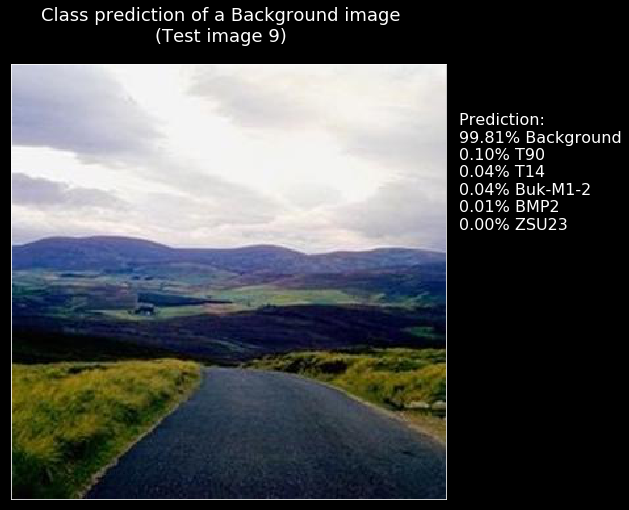

Image 10 : [(99.61, 'Background'), (0.11, 'BMP2'), (0.1, 'T90'), (0.1, 'T14'), (0.07, 'Buk-M1-2'), (0.0, 'ZSU23')] 



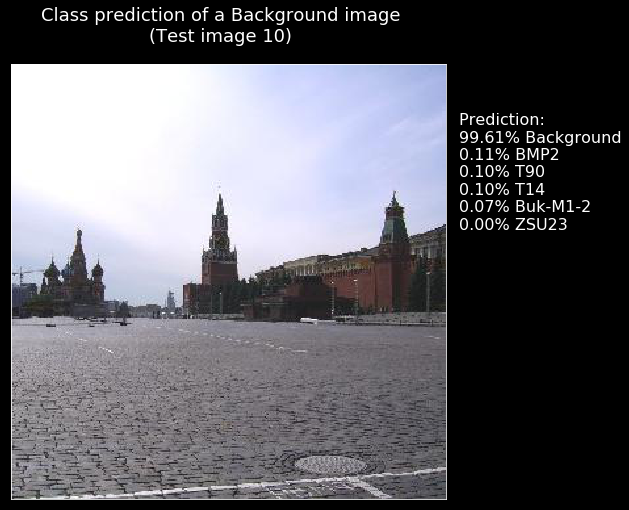

Image 11 : [(99.4, 'Background'), (0.29, 'T90'), (0.19, 'Buk-M1-2'), (0.06, 'T14'), (0.06, 'BMP2'), (0.0, 'ZSU23')] 



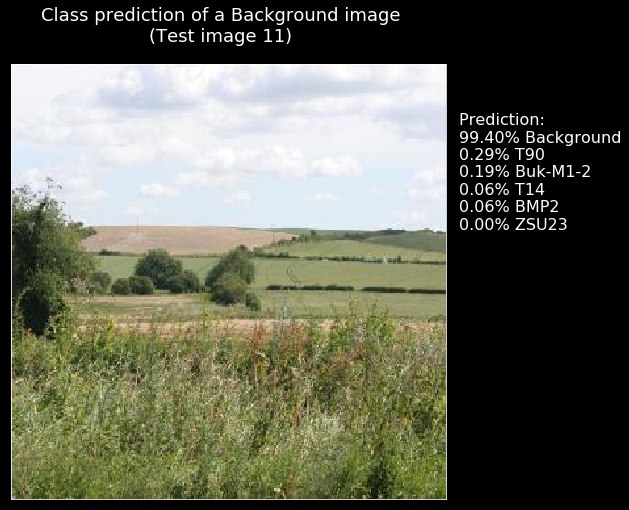

Image 12 : [(99.53, 'Background'), (0.3, 'T90'), (0.09, 'Buk-M1-2'), (0.06, 'T14'), (0.01, 'BMP2'), (0.0, 'ZSU23')] 



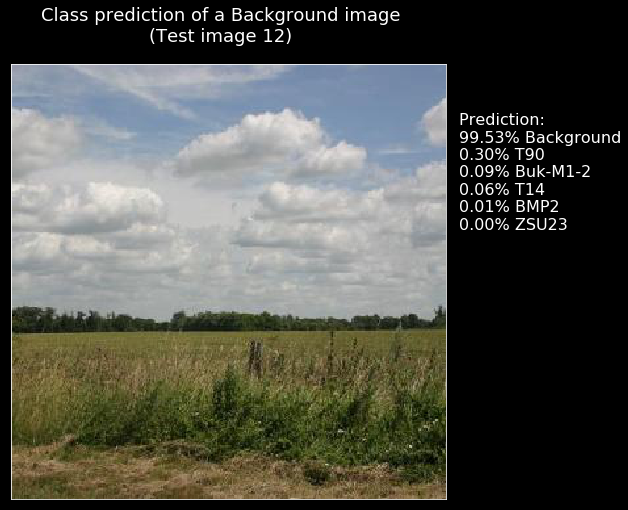

Image 13 : [(99.47, 'Background'), (0.43, 'T90'), (0.05, 'Buk-M1-2'), (0.03, 'T14'), (0.01, 'BMP2'), (0.0, 'ZSU23')] 



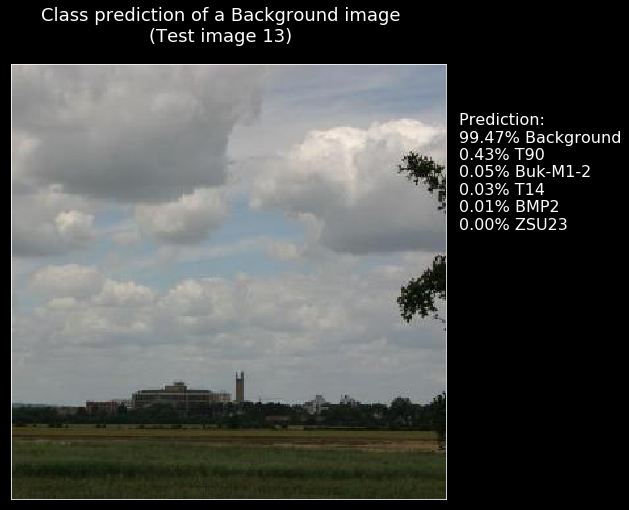

Image 14 : [(99.69, 'Background'), (0.24, 'Buk-M1-2'), (0.03, 'BMP2'), (0.02, 'T90'), (0.01, 'T14'), (0.0, 'ZSU23')] 



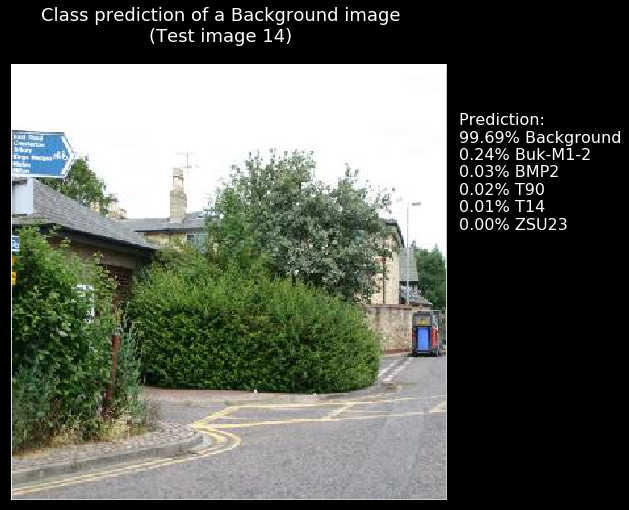

Image 15 : [(98.41, 'Background'), (0.63, 'Buk-M1-2'), (0.49, 'T90'), (0.3, 'BMP2'), (0.15, 'T14'), (0.0, 'ZSU23')] 



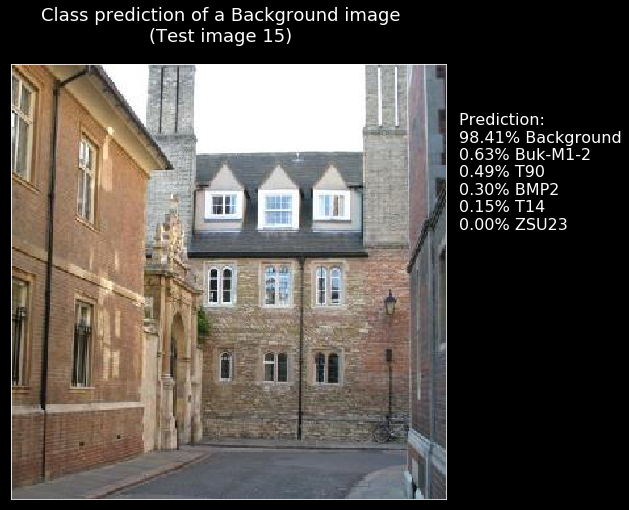

Image 16 : [(90.15, 'BMP2'), (5.29, 'T14'), (2.47, 'T90'), (1.62, 'ZSU23'), (0.27, 'Background'), (0.21, 'Buk-M1-2')] 



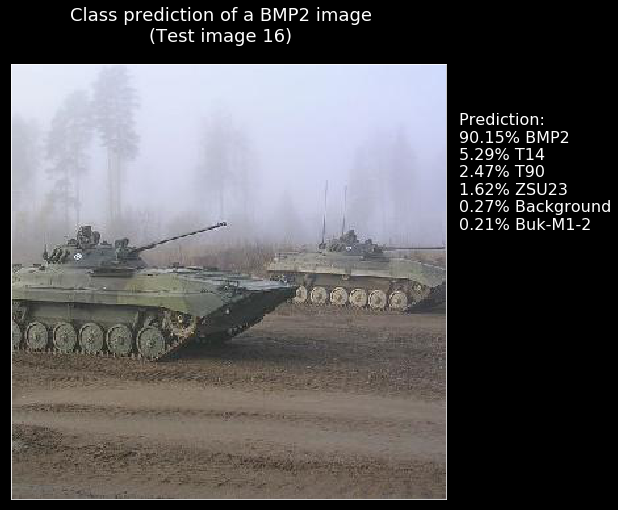

Image 17 : [(98.5, 'BMP2'), (0.67, 'T90'), (0.27, 'T14'), (0.27, 'Background'), (0.19, 'Buk-M1-2'), (0.11, 'ZSU23')] 



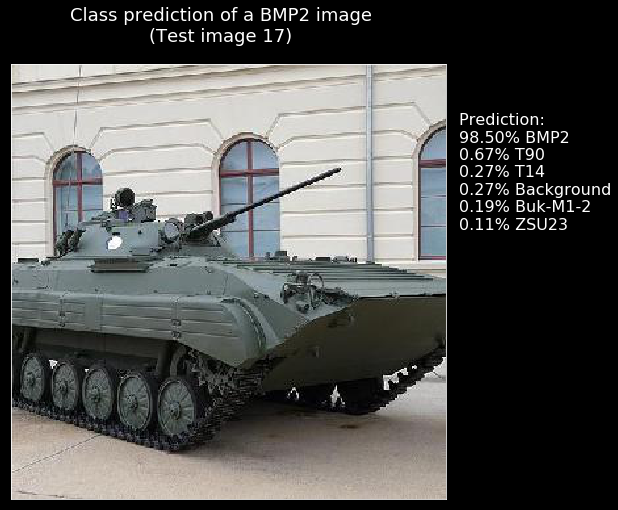

Image 18 : [(47.5, 'Buk-M1-2'), (23.63, 'ZSU23'), (14.0, 'T90'), (8.07, 'BMP2'), (4.83, 'Background'), (1.97, 'T14')] 



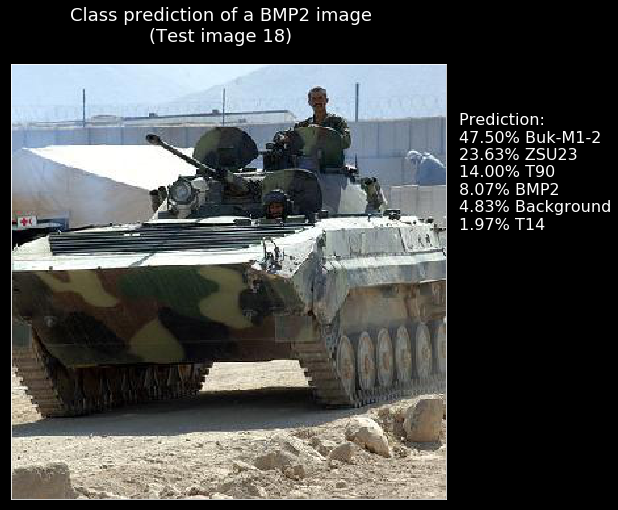

Image 19 : [(77.28, 'BMP2'), (9.51, 'T90'), (5.74, 'T14'), (3.15, 'ZSU23'), (2.53, 'Background'), (1.8, 'Buk-M1-2')] 



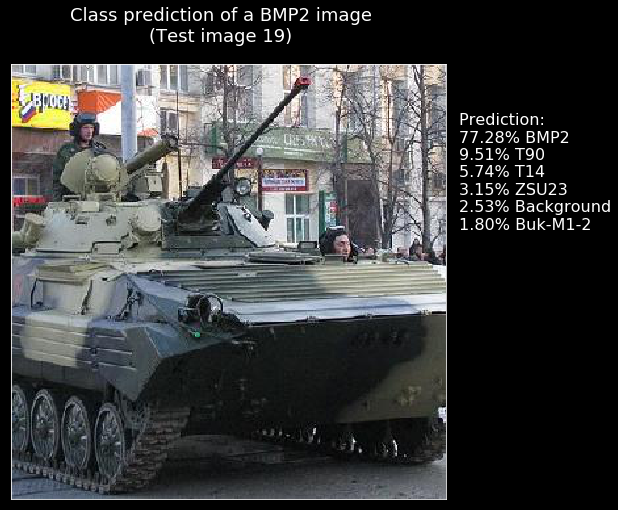

Image 20 : [(92.93, 'BMP2'), (5.88, 'T90'), (0.5, 'T14'), (0.37, 'Background'), (0.17, 'Buk-M1-2'), (0.14, 'ZSU23')] 



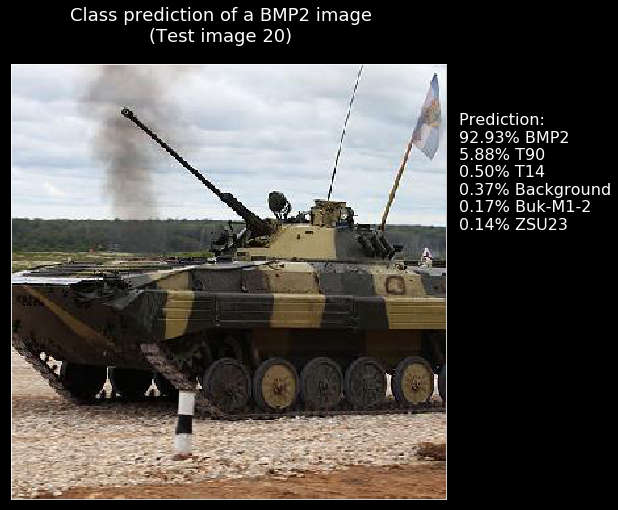

Image 21 : [(63.4, 'BMP2'), (26.84, 'Buk-M1-2'), (7.26, 'Background'), (1.08, 'T14'), (0.81, 'ZSU23'), (0.62, 'T90')] 



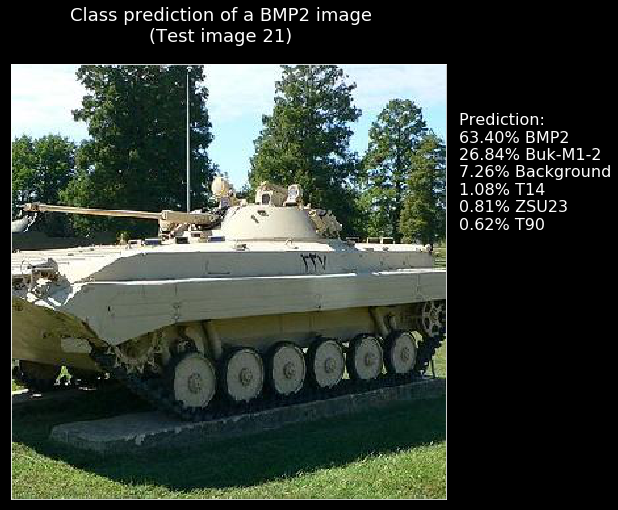

Image 22 : [(95.31, 'BMP2'), (1.8, 'ZSU23'), (0.9, 'Buk-M1-2'), (0.89, 'T90'), (0.58, 'Background'), (0.51, 'T14')] 



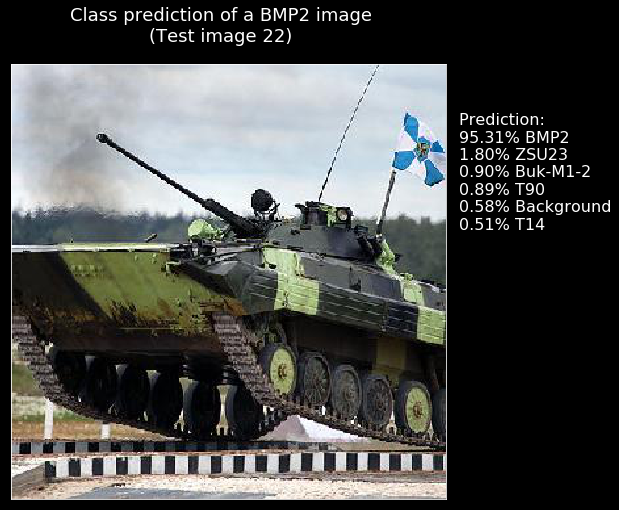

Image 23 : [(98.98, 'BMP2'), (0.58, 'T90'), (0.22, 'Buk-M1-2'), (0.09, 'ZSU23'), (0.07, 'Background'), (0.05, 'T14')] 



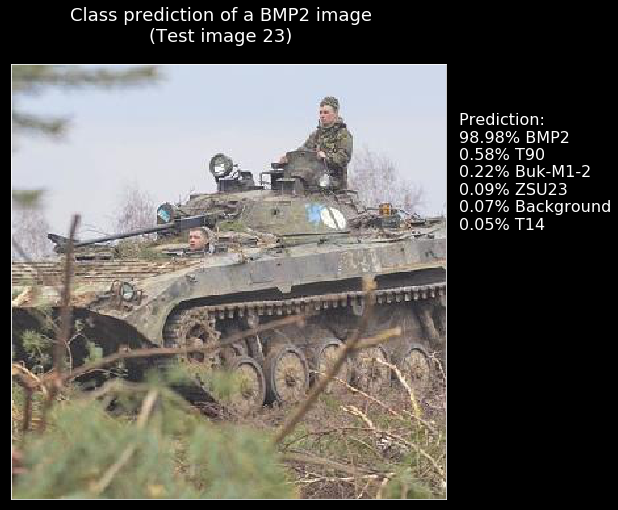

Image 24 : [(77.74, 'BMP2'), (15.77, 'T14'), (4.69, 'T90'), (1.02, 'ZSU23'), (0.43, 'Background'), (0.34, 'Buk-M1-2')] 



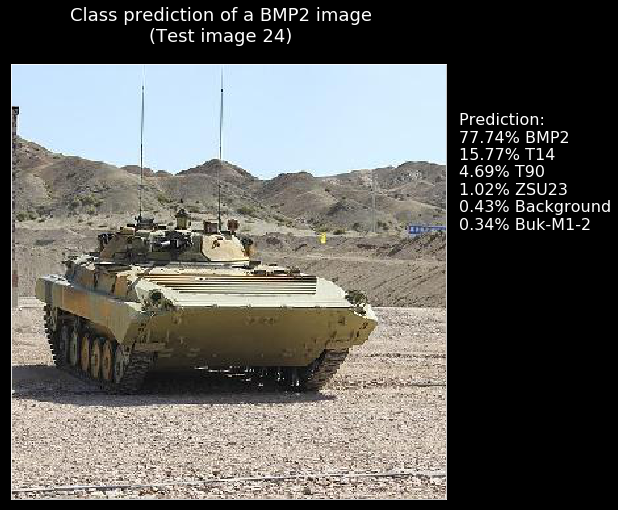

Image 25 : [(99.3, 'BMP2'), (0.27, 'T14'), (0.2, 'T90'), (0.09, 'ZSU23'), (0.08, 'Background'), (0.06, 'Buk-M1-2')] 



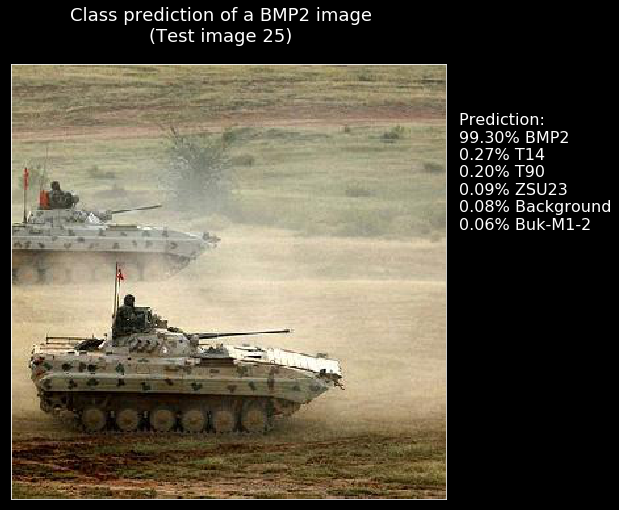

Image 26 : [(74.88, 'BMP2'), (12.87, 'T90'), (8.76, 'ZSU23'), (1.44, 'T14'), (1.39, 'Buk-M1-2'), (0.66, 'Background')] 



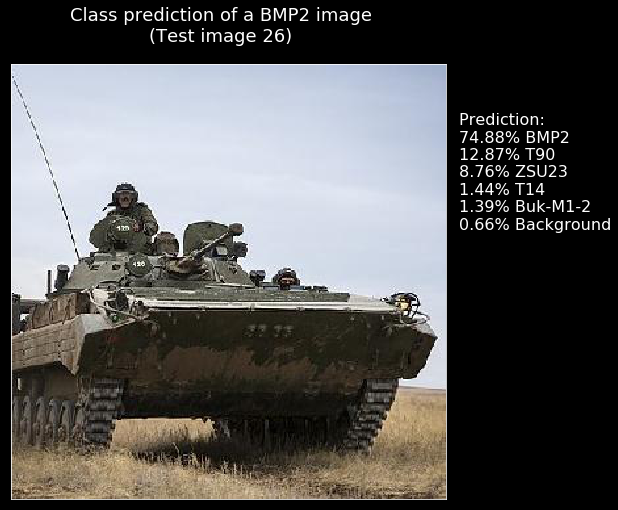

Image 27 : [(54.42, 'T14'), (30.85, 'T90'), (7.21, 'BMP2'), (4.47, 'Background'), (2.9, 'Buk-M1-2'), (0.14, 'ZSU23')] 



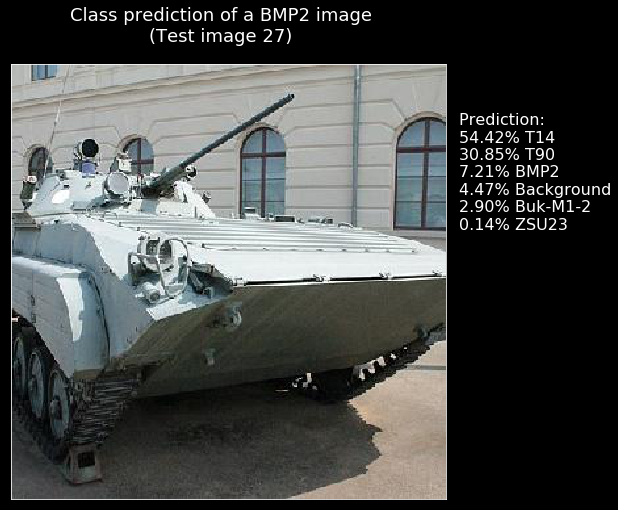

Image 28 : [(91.89, 'BMP2'), (5.86, 'T90'), (1.51, 'T14'), (0.6, 'ZSU23'), (0.09, 'Background'), (0.04, 'Buk-M1-2')] 



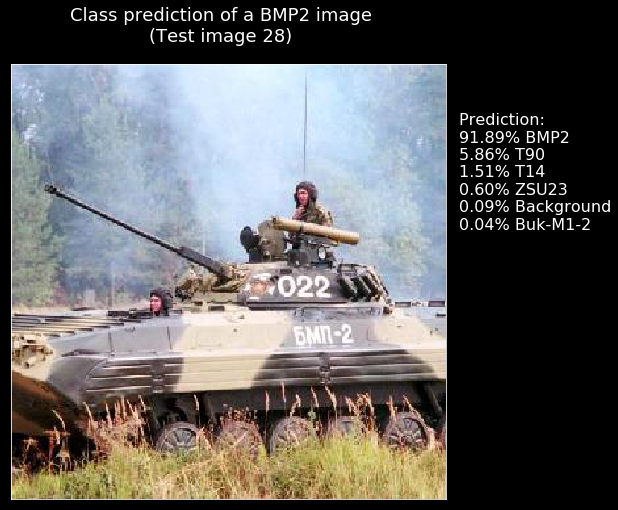

Image 29 : [(50.93, 'Background'), (29.44, 'BMP2'), (12.54, 'T14'), (4.97, 'T90'), (1.34, 'Buk-M1-2'), (0.78, 'ZSU23')] 



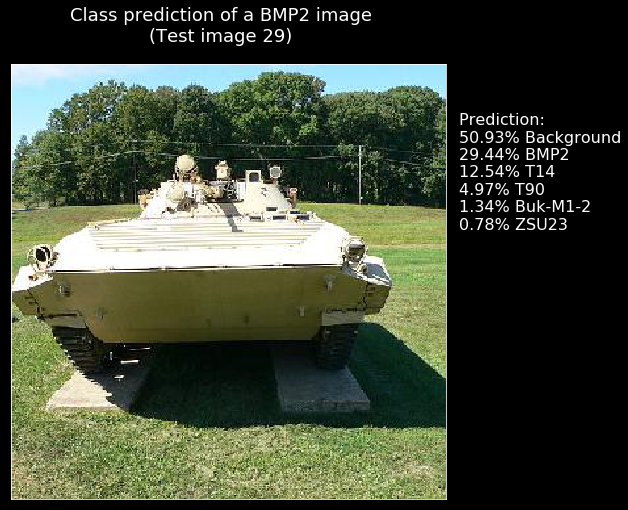

Image 30 : [(84.18, 'BMP2'), (13.99, 'T14'), (0.73, 'Background'), (0.54, 'T90'), (0.31, 'ZSU23'), (0.26, 'Buk-M1-2')] 



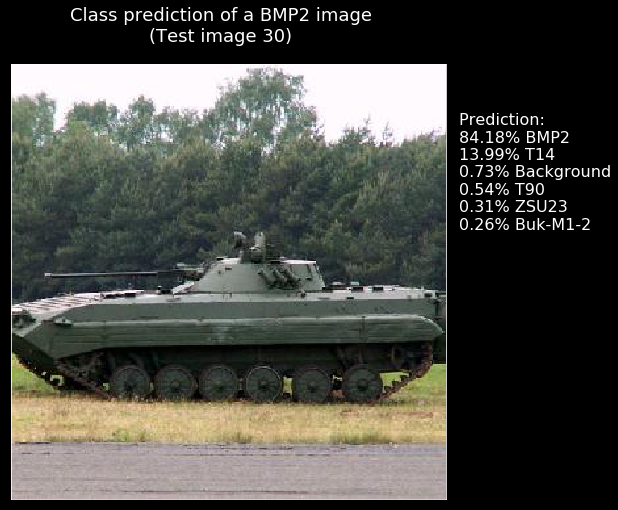

Image 31 : [(99.88, 'Buk-M1-2'), (0.06, 'Background'), (0.04, 'BMP2'), (0.01, 'ZSU23'), (0.01, 'T90'), (0.0, 'T14')] 



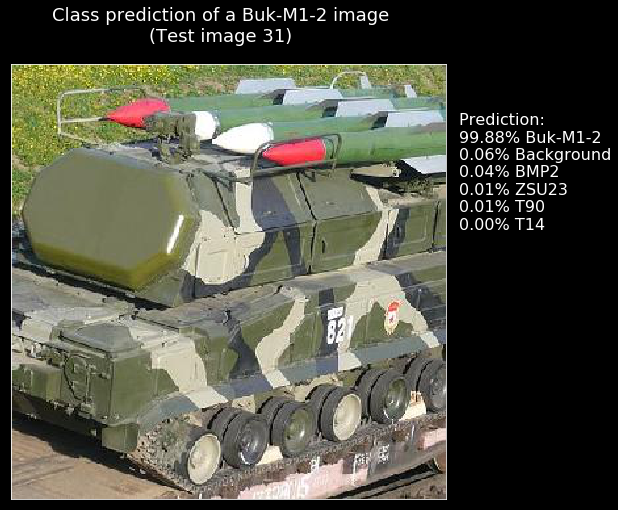

Image 32 : [(98.18, 'Buk-M1-2'), (0.93, 'BMP2'), (0.45, 'Background'), (0.32, 'T90'), (0.09, 'ZSU23'), (0.03, 'T14')] 



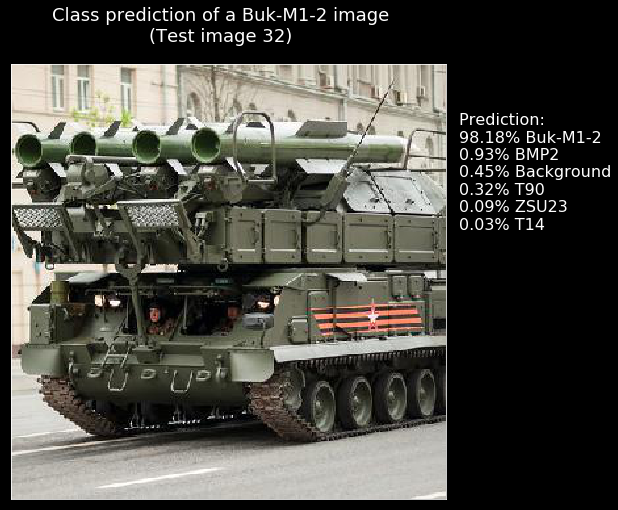

Image 33 : [(98.76, 'Buk-M1-2'), (0.63, 'BMP2'), (0.39, 'Background'), (0.17, 'T90'), (0.04, 'ZSU23'), (0.01, 'T14')] 



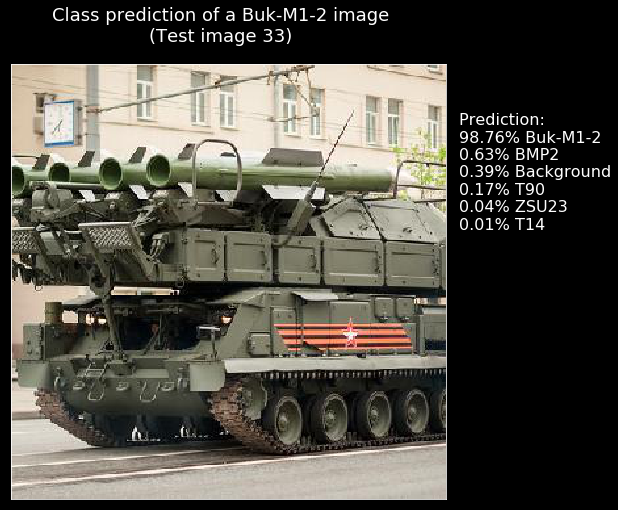

Image 34 : [(97.56, 'Buk-M1-2'), (1.0, 'ZSU23'), (0.71, 'Background'), (0.42, 'BMP2'), (0.27, 'T90'), (0.05, 'T14')] 



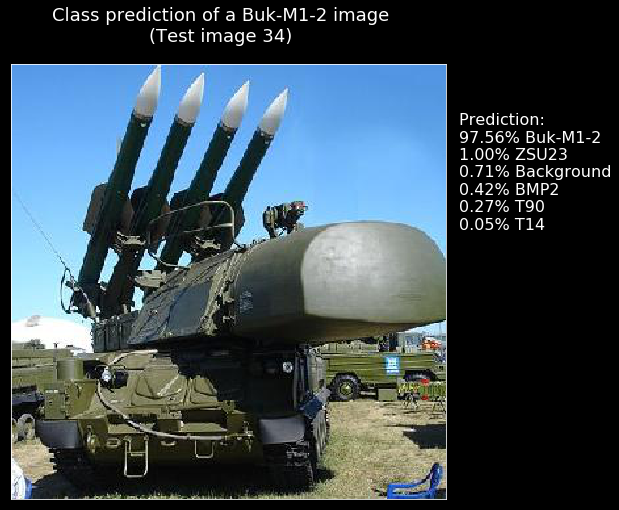

Image 35 : [(95.5, 'Buk-M1-2'), (3.29, 'Background'), (0.5, 'T90'), (0.43, 'BMP2'), (0.24, 'T14'), (0.05, 'ZSU23')] 



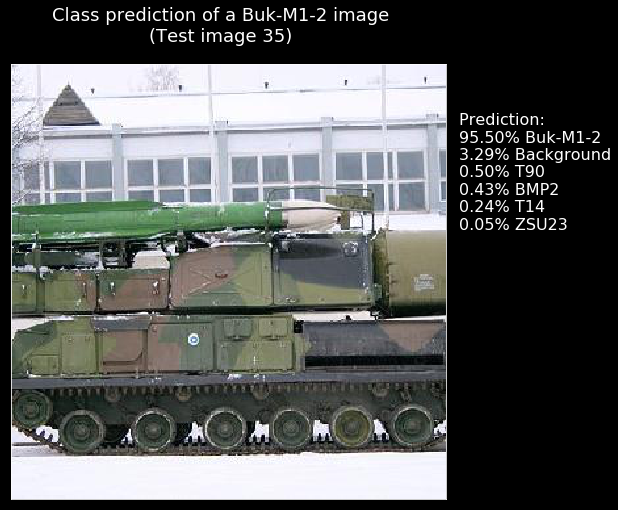

Image 36 : [(94.02, 'Buk-M1-2'), (2.64, 'Background'), (1.86, 'T90'), (0.7, 'ZSU23'), (0.6, 'BMP2'), (0.17, 'T14')] 



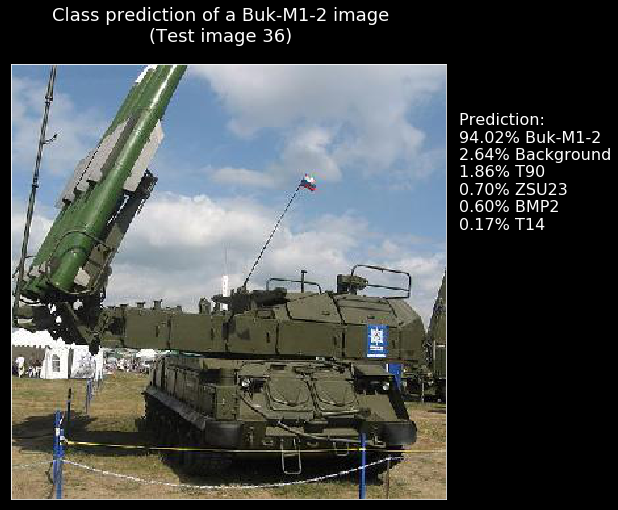

Image 37 : [(89.09, 'Buk-M1-2'), (5.98, 'BMP2'), (1.76, 'T90'), (1.73, 'ZSU23'), (1.02, 'Background'), (0.43, 'T14')] 



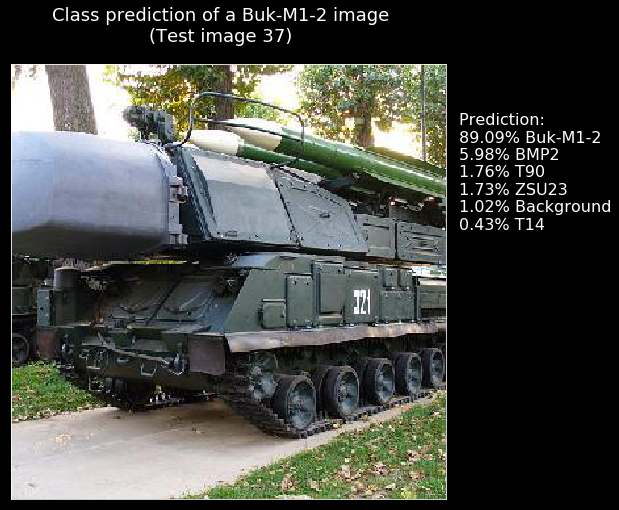

Image 38 : [(99.11, 'Buk-M1-2'), (0.49, 'ZSU23'), (0.19, 'Background'), (0.17, 'BMP2'), (0.04, 'T90'), (0.0, 'T14')] 



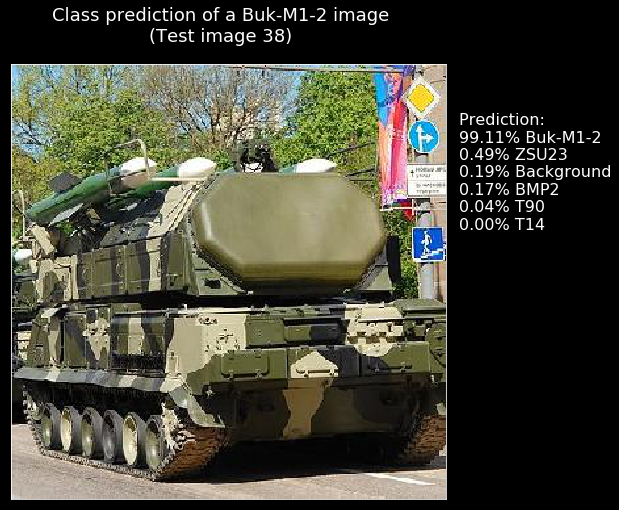

Image 39 : [(95.84, 'Buk-M1-2'), (1.77, 'BMP2'), (1.31, 'T90'), (0.63, 'Background'), (0.39, 'ZSU23'), (0.06, 'T14')] 



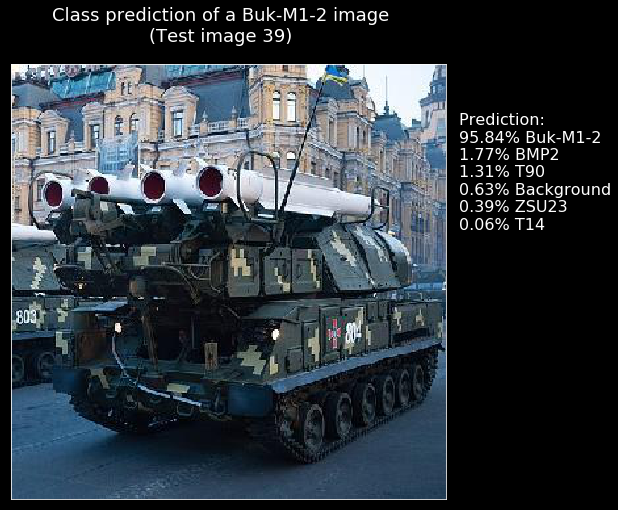

Image 40 : [(99.52, 'Buk-M1-2'), (0.26, 'Background'), (0.12, 'T90'), (0.07, 'BMP2'), (0.01, 'ZSU23'), (0.01, 'T14')] 



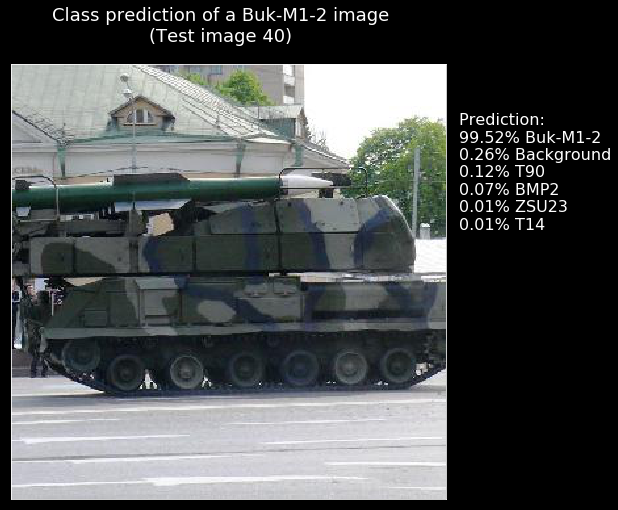

Image 41 : [(98.17, 'Buk-M1-2'), (0.74, 'ZSU23'), (0.71, 'BMP2'), (0.21, 'Background'), (0.14, 'T90'), (0.02, 'T14')] 



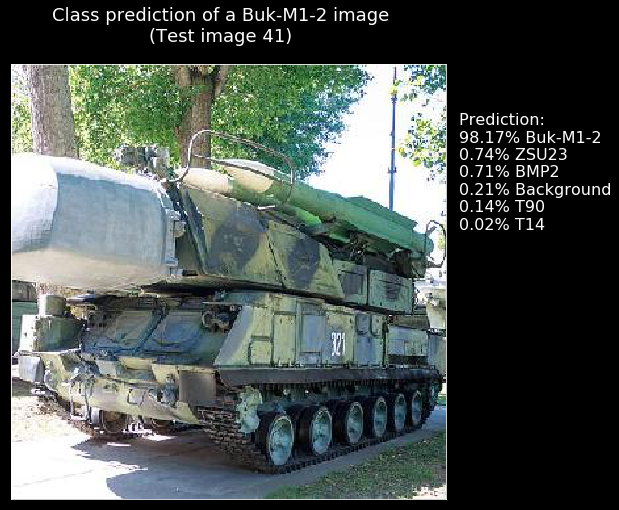

Image 42 : [(99.7, 'Buk-M1-2'), (0.15, 'BMP2'), (0.12, 'Background'), (0.03, 'T90'), (0.0, 'ZSU23'), (0.0, 'T14')] 



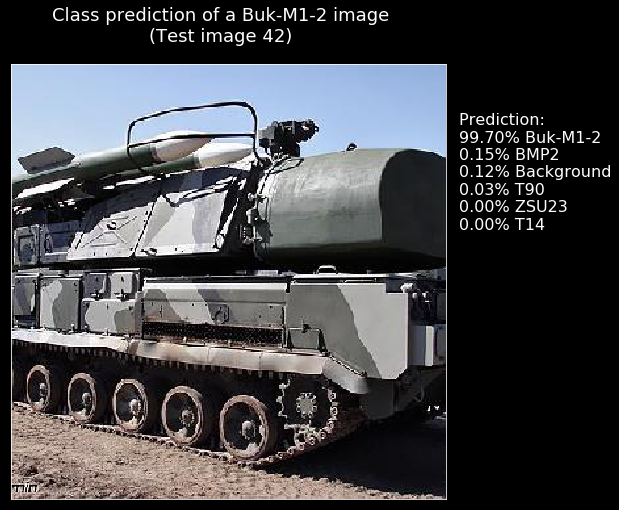

Image 43 : [(85.86, 'Buk-M1-2'), (12.67, 'BMP2'), (0.73, 'Background'), (0.4, 'T90'), (0.27, 'ZSU23'), (0.08, 'T14')] 



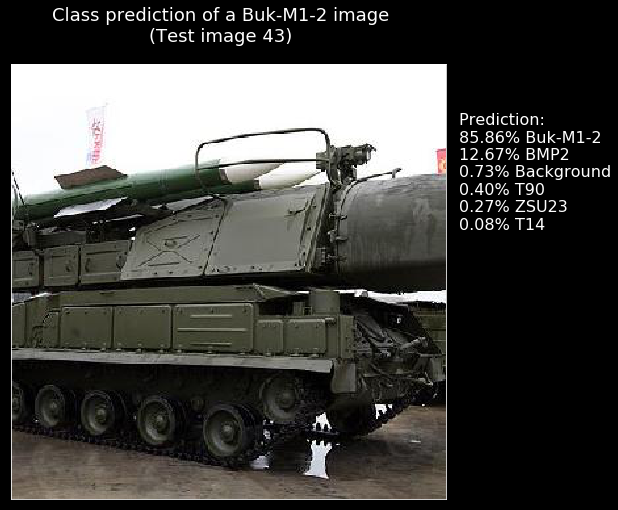

Image 44 : [(88.5, 'Buk-M1-2'), (4.89, 'BMP2'), (3.83, 'Background'), (2.05, 'T90'), (0.58, 'ZSU23'), (0.15, 'T14')] 



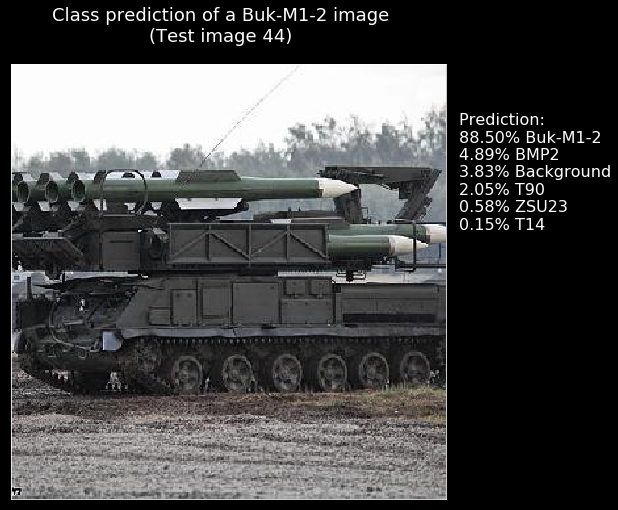

Image 45 : [(97.79, 'Buk-M1-2'), (1.39, 'Background'), (0.41, 'BMP2'), (0.24, 'T90'), (0.12, 'ZSU23'), (0.06, 'T14')] 



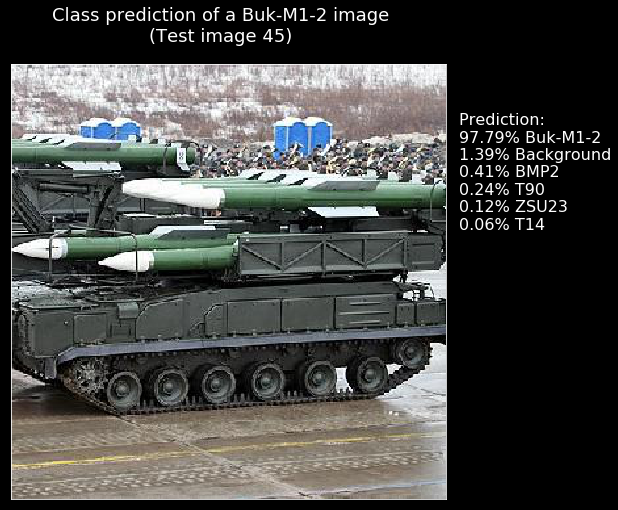

Image 46 : [(99.13, 'BMP2'), (0.3, 'Background'), (0.27, 'T14'), (0.21, 'T90'), (0.08, 'Buk-M1-2'), (0.01, 'ZSU23')] 



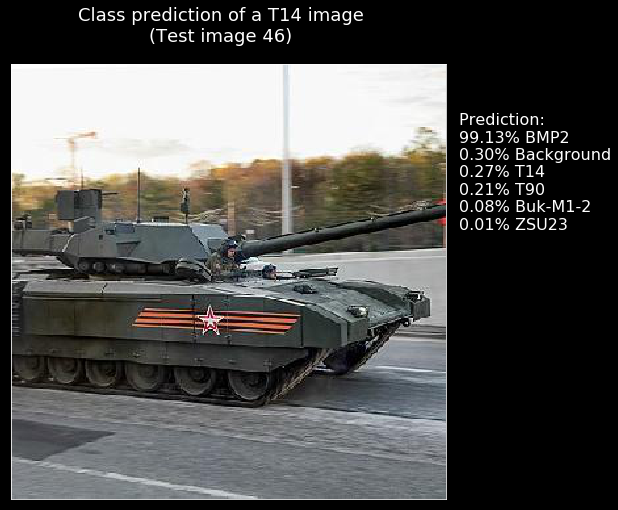

Image 47 : [(41.74, 'BMP2'), (33.45, 'T14'), (9.28, 'T90'), (8.67, 'Buk-M1-2'), (5.42, 'Background'), (1.44, 'ZSU23')] 



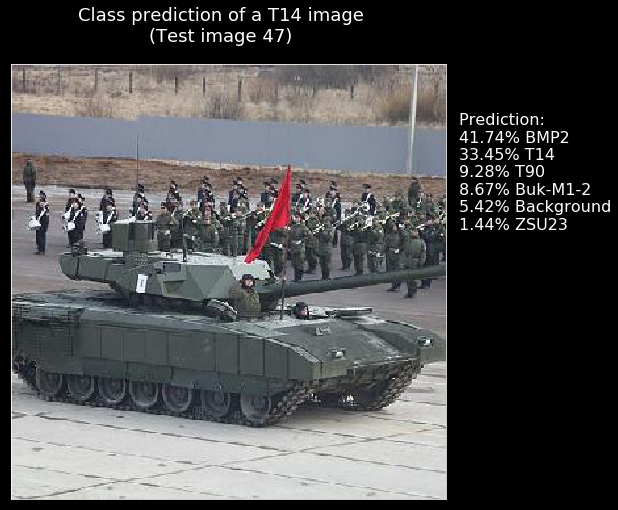

Image 48 : [(79.31, 'Buk-M1-2'), (14.7, 'BMP2'), (2.51, 'T90'), (2.1, 'Background'), (1.04, 'T14'), (0.34, 'ZSU23')] 



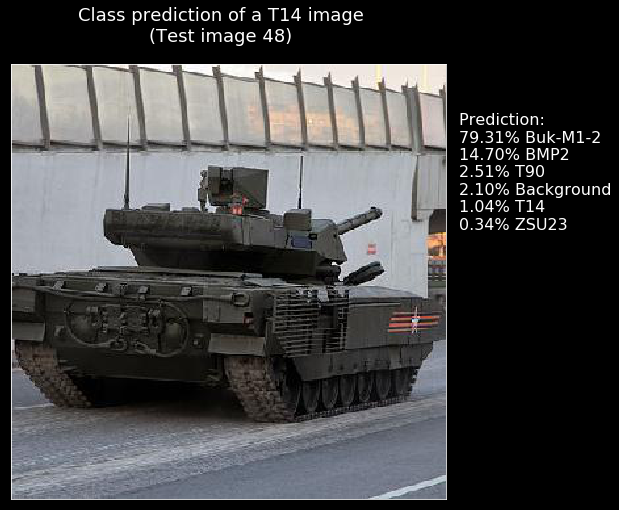

Image 49 : [(68.37, 'T14'), (18.7, 'BMP2'), (8.98, 'T90'), (1.99, 'Background'), (1.58, 'Buk-M1-2'), (0.38, 'ZSU23')] 



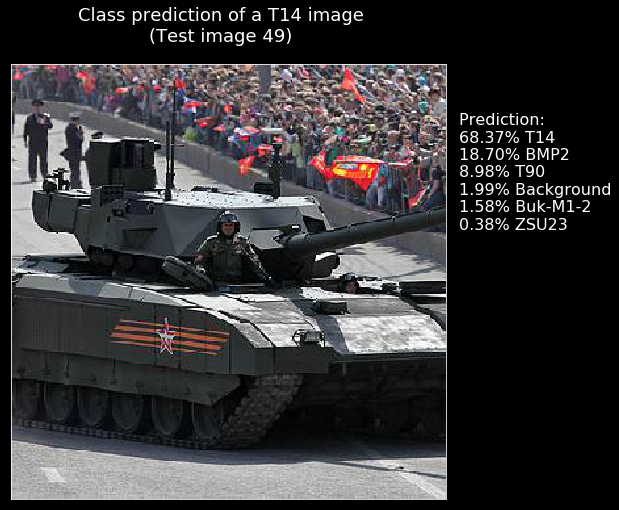

Image 50 : [(47.08, 'Buk-M1-2'), (27.03, 'Background'), (9.17, 'ZSU23'), (8.99, 'T14'), (4.87, 'T90'), (2.85, 'BMP2')] 



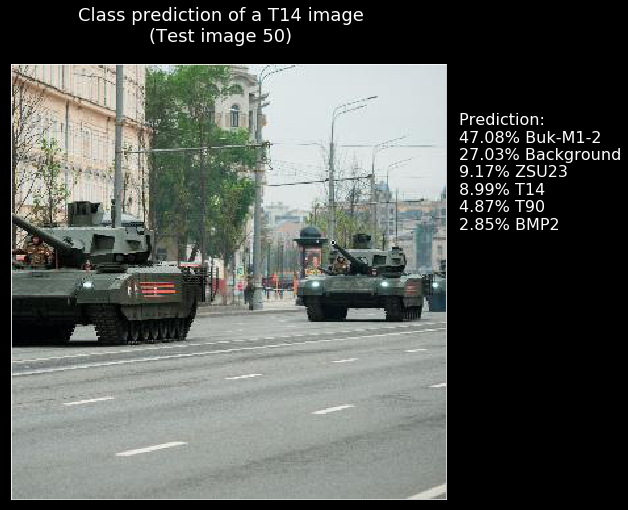

Image 51 : [(59.5, 'T14'), (31.05, 'BMP2'), (4.51, 'T90'), (3.58, 'Background'), (1.23, 'Buk-M1-2'), (0.13, 'ZSU23')] 



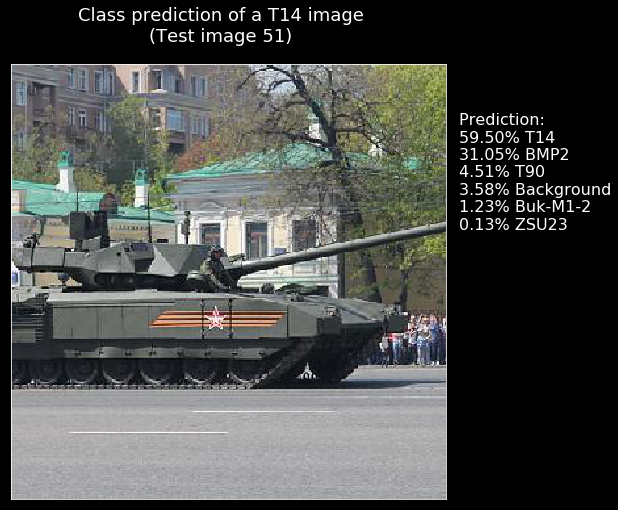

Image 52 : [(69.66, 'T14'), (21.31, 'T90'), (4.35, 'BMP2'), (2.54, 'Background'), (1.95, 'Buk-M1-2'), (0.19, 'ZSU23')] 



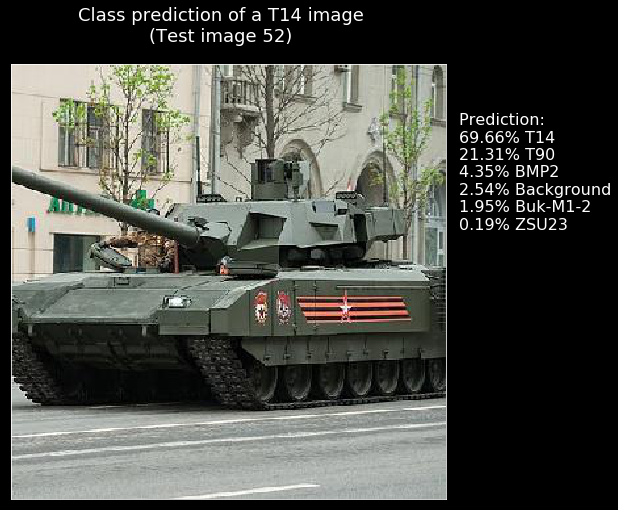

Image 53 : [(46.93, 'T14'), (23.27, 'BMP2'), (13.27, 'T90'), (12.03, 'Buk-M1-2'), (4.11, 'Background'), (0.38, 'ZSU23')] 



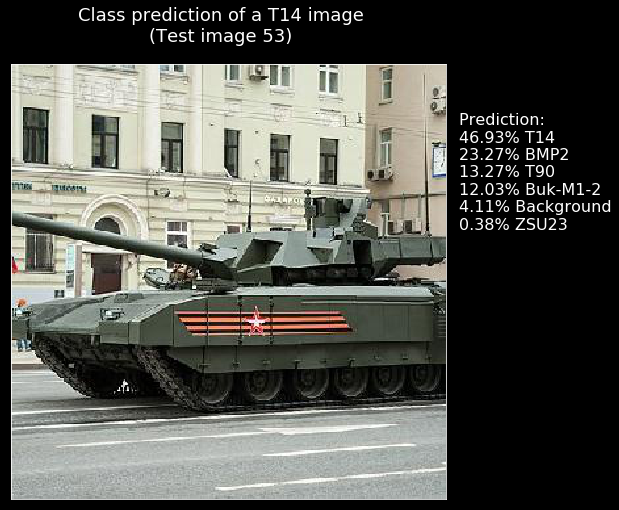

Image 54 : [(57.46, 'T14'), (41.1, 'BMP2'), (0.81, 'T90'), (0.26, 'ZSU23'), (0.23, 'Background'), (0.14, 'Buk-M1-2')] 



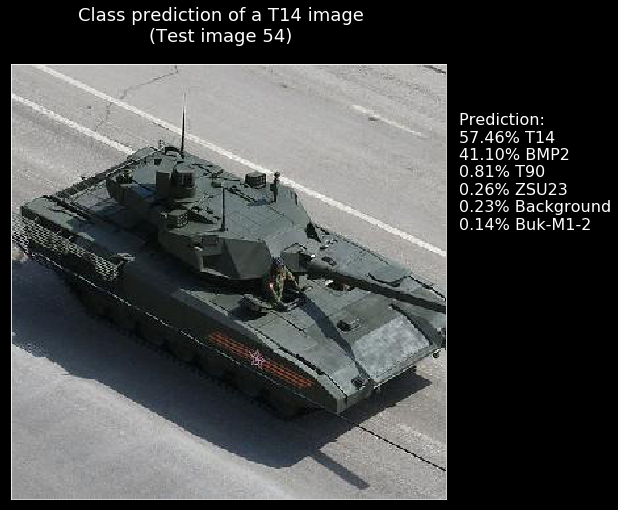

Image 55 : [(83.91, 'ZSU23'), (6.17, 'Buk-M1-2'), (5.25, 'T90'), (2.12, 'Background'), (1.84, 'BMP2'), (0.72, 'T14')] 



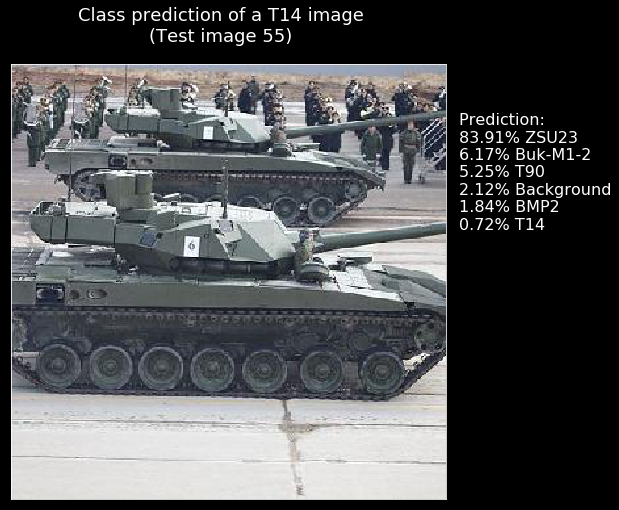

Image 56 : [(31.94, 'ZSU23'), (23.87, 'BMP2'), (18.99, 'Buk-M1-2'), (13.92, 'T14'), (9.06, 'T90'), (2.21, 'Background')] 



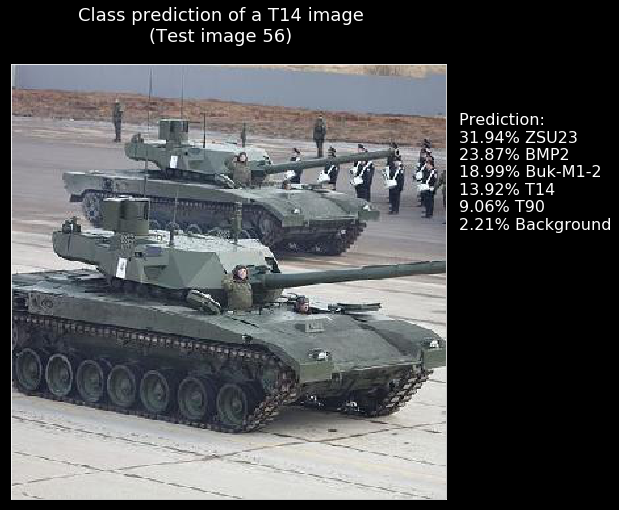

Image 57 : [(55.54, 'T14'), (22.67, 'T90'), (15.31, 'Buk-M1-2'), (4.15, 'Background'), (1.96, 'BMP2'), (0.37, 'ZSU23')] 



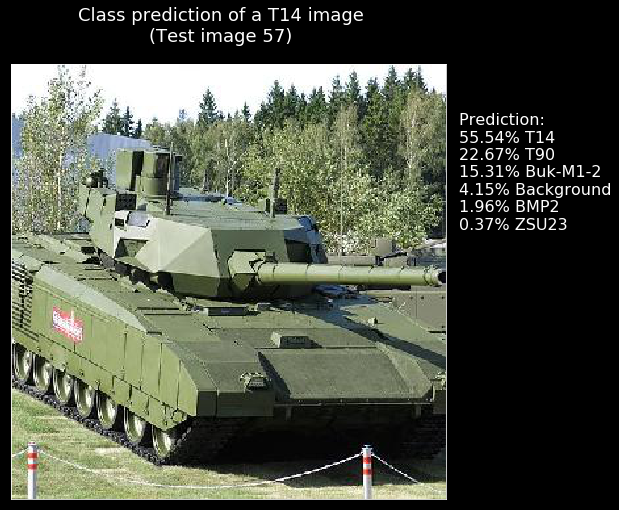

Image 58 : [(73.61, 'T14'), (19.26, 'T90'), (3.3, 'Background'), (2.15, 'BMP2'), (1.24, 'Buk-M1-2'), (0.45, 'ZSU23')] 



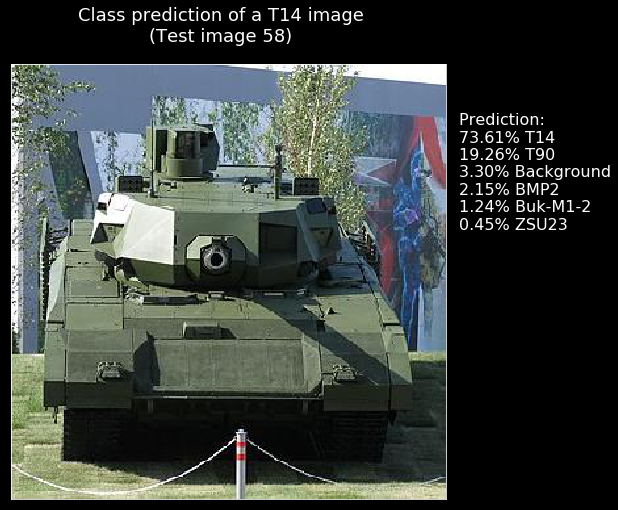

Image 59 : [(51.67, 'T14'), (29.71, 'T90'), (8.29, 'Buk-M1-2'), (7.1, 'BMP2'), (2.02, 'ZSU23'), (1.21, 'Background')] 



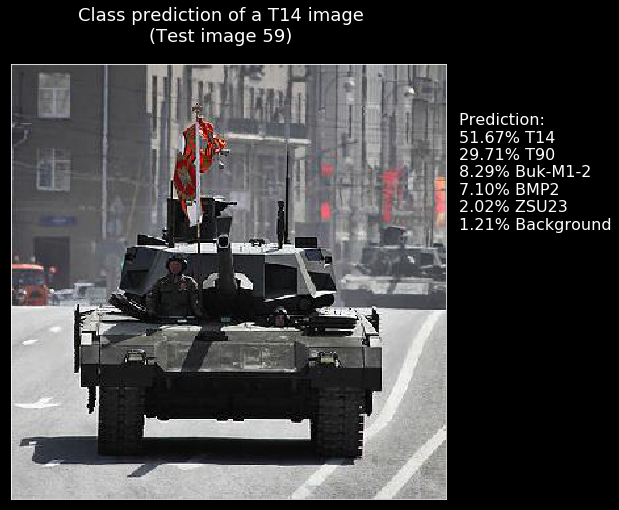

Image 60 : [(74.92, 'T14'), (15.5, 'T90'), (6.59, 'BMP2'), (2.07, 'Background'), (0.87, 'Buk-M1-2'), (0.05, 'ZSU23')] 



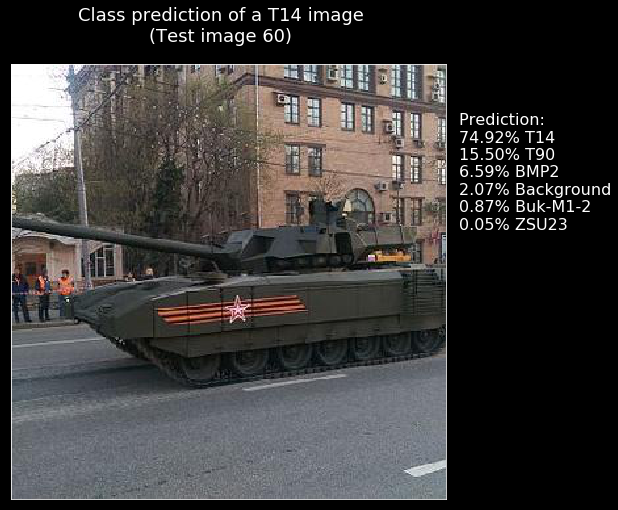

Image 61 : [(74.68, 'T90'), (19.37, 'T14'), (2.91, 'BMP2'), (1.54, 'Buk-M1-2'), (1.11, 'Background'), (0.38, 'ZSU23')] 



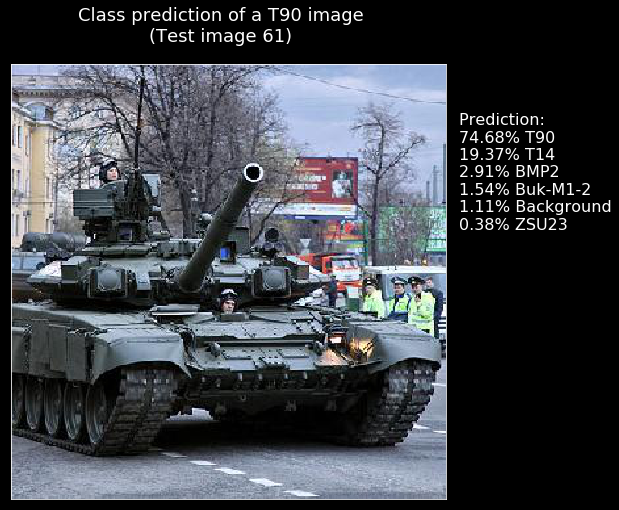

Image 62 : [(84.04, 'T90'), (6.67, 'BMP2'), (6.5, 'T14'), (1.28, 'Background'), (0.8, 'ZSU23'), (0.7, 'Buk-M1-2')] 



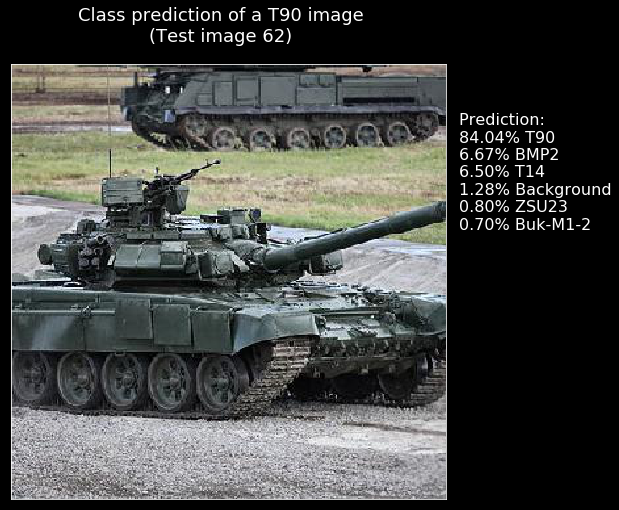

Image 63 : [(74.9, 'T90'), (15.04, 'T14'), (7.06, 'BMP2'), (1.52, 'Background'), (1.01, 'Buk-M1-2'), (0.47, 'ZSU23')] 



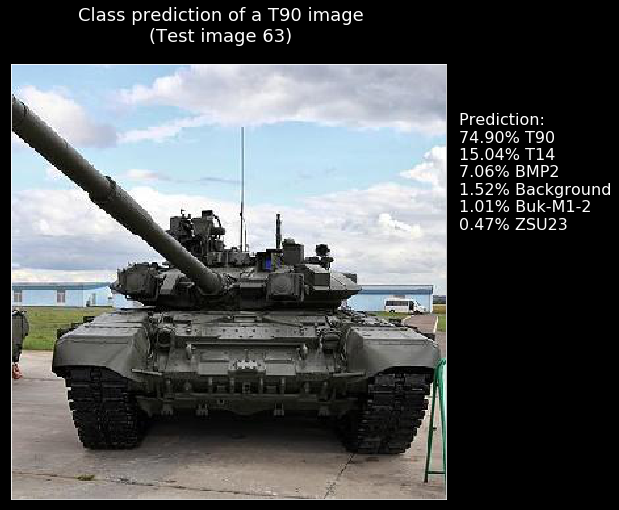

Image 64 : [(94.23, 'T90'), (3.2, 'T14'), (1.16, 'BMP2'), (1.02, 'Background'), (0.33, 'Buk-M1-2'), (0.05, 'ZSU23')] 



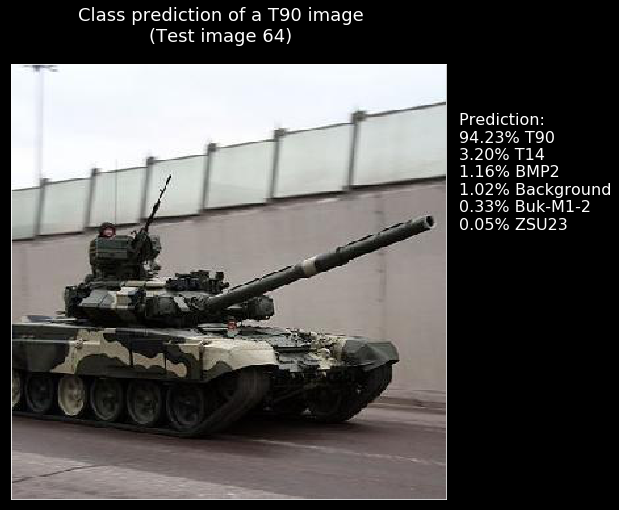

Image 65 : [(70.74, 'T90'), (11.5, 'ZSU23'), (7.12, 'T14'), (4.27, 'Buk-M1-2'), (3.55, 'Background'), (2.81, 'BMP2')] 



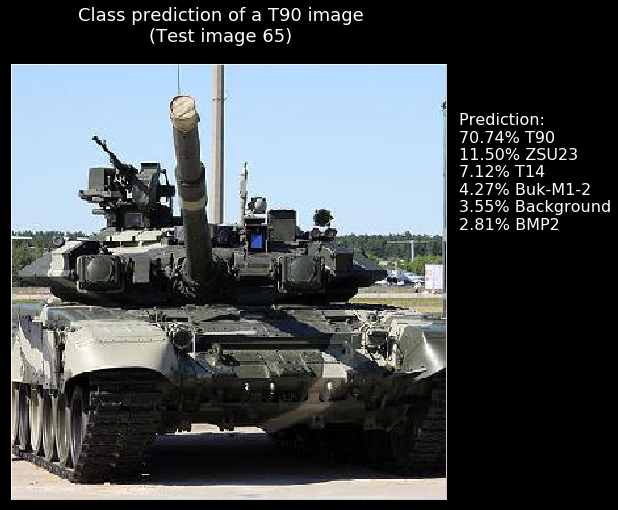

Image 66 : [(80.81, 'T90'), (14.55, 'T14'), (2.56, 'BMP2'), (1.01, 'Buk-M1-2'), (0.76, 'Background'), (0.32, 'ZSU23')] 



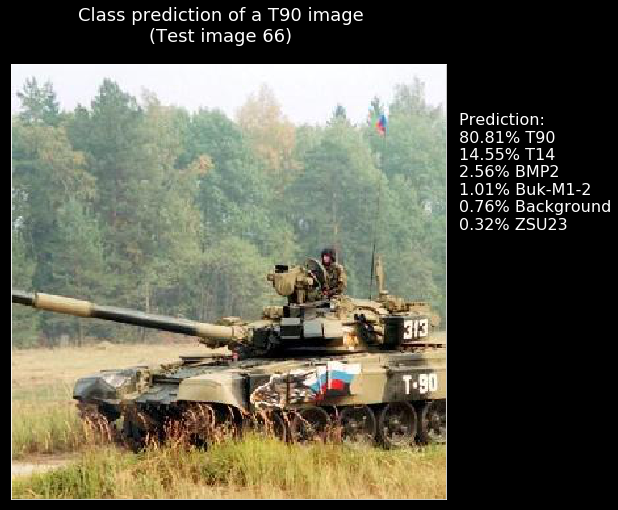

Image 67 : [(86.36, 'T90'), (7.22, 'T14'), (2.68, 'Buk-M1-2'), (2.13, 'Background'), (1.53, 'BMP2'), (0.08, 'ZSU23')] 



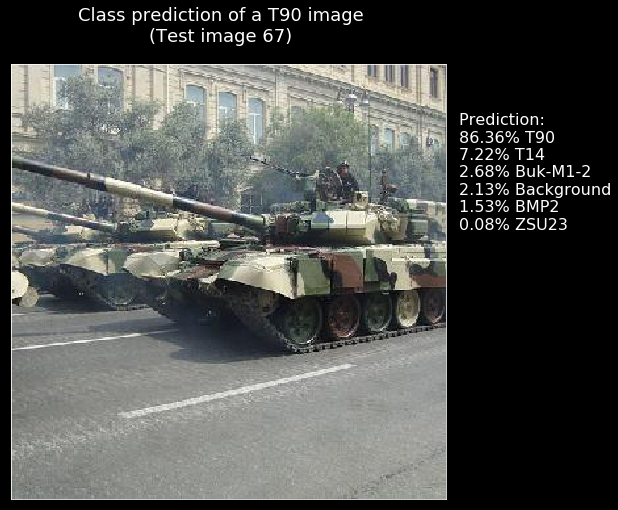

Image 68 : [(87.21, 'T90'), (8.17, 'T14'), (2.2, 'BMP2'), (1.18, 'Background'), (0.68, 'Buk-M1-2'), (0.57, 'ZSU23')] 



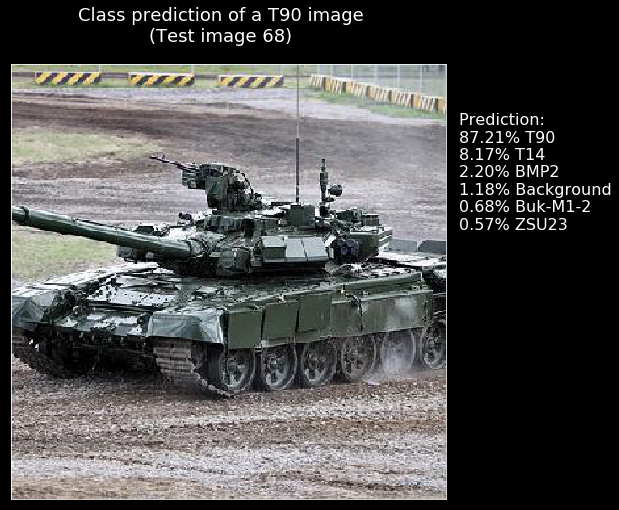

Image 69 : [(58.25, 'T14'), (16.87, 'T90'), (12.62, 'Buk-M1-2'), (6.51, 'Background'), (4.51, 'ZSU23'), (1.24, 'BMP2')] 



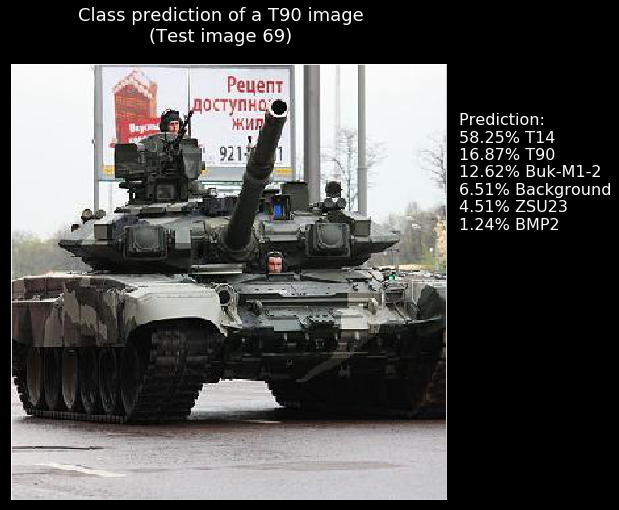

Image 70 : [(70.88, 'T90'), (11.72, 'Buk-M1-2'), (8.47, 'BMP2'), (6.04, 'T14'), (2.49, 'Background'), (0.41, 'ZSU23')] 



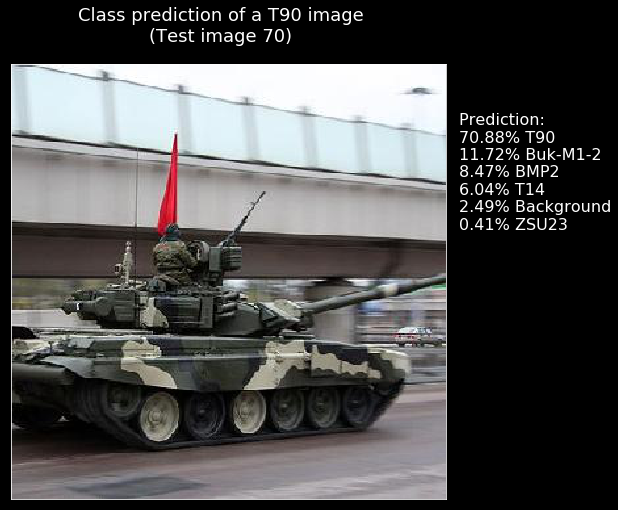

Image 71 : [(85.06, 'T90'), (6.5, 'T14'), (3.96, 'Buk-M1-2'), (2.07, 'Background'), (2.01, 'BMP2'), (0.4, 'ZSU23')] 



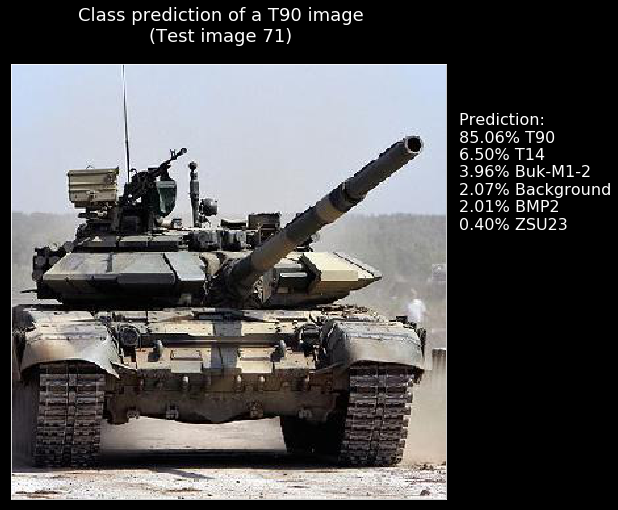

Image 72 : [(42.15, 'T90'), (30.26, 'Buk-M1-2'), (20.72, 'BMP2'), (3.4, 'Background'), (2.29, 'ZSU23'), (1.18, 'T14')] 



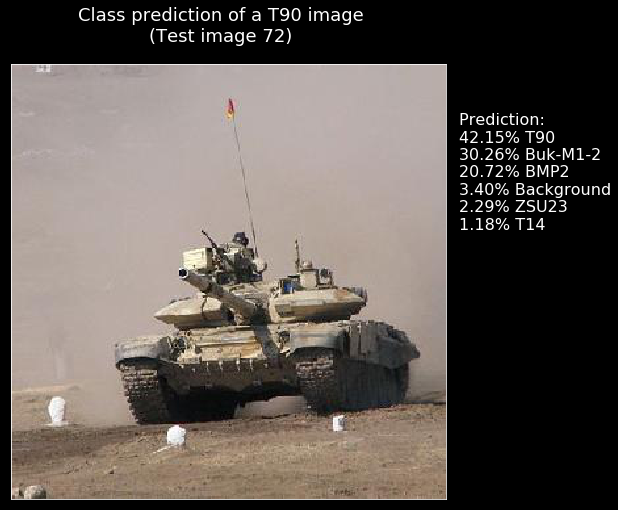

Image 73 : [(49.05, 'T90'), (40.29, 'T14'), (8.61, 'BMP2'), (0.88, 'Background'), (0.85, 'Buk-M1-2'), (0.32, 'ZSU23')] 



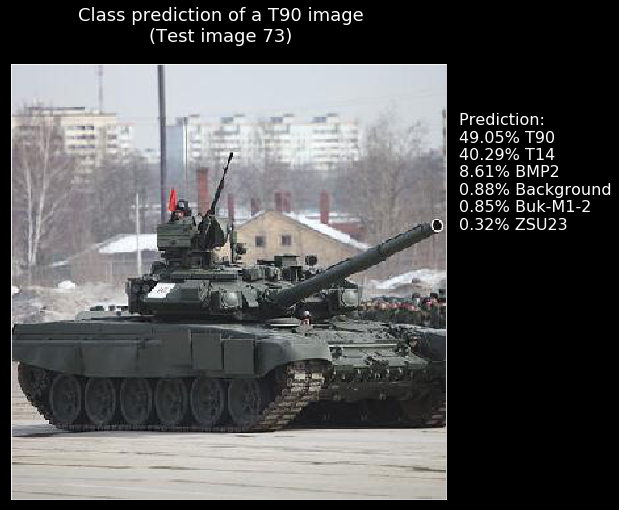

Image 74 : [(83.05, 'T90'), (10.46, 'T14'), (4.59, 'BMP2'), (0.67, 'Buk-M1-2'), (0.63, 'ZSU23'), (0.58, 'Background')] 



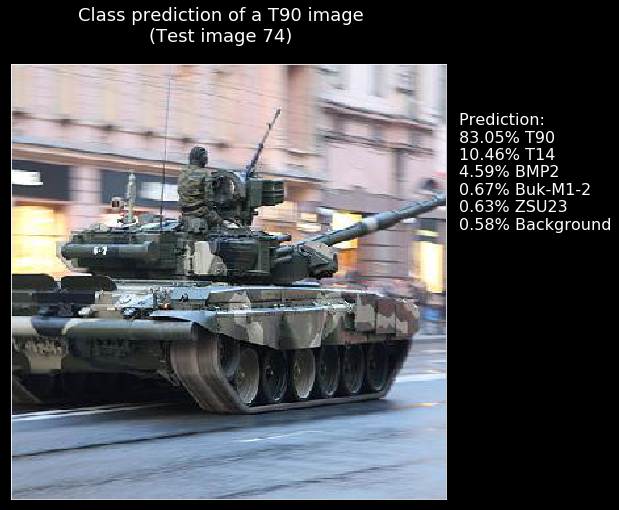

Image 75 : [(70.87, 'T90'), (23.18, 'T14'), (2.32, 'BMP2'), (2.28, 'Background'), (1.25, 'Buk-M1-2'), (0.11, 'ZSU23')] 



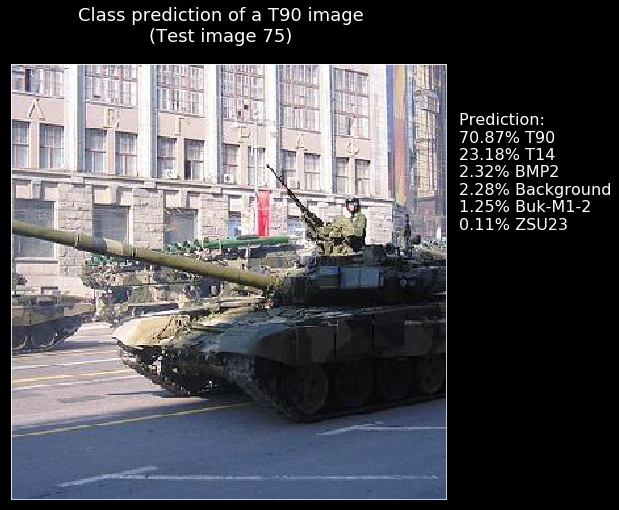

Image 76 : [(96.15, 'ZSU23'), (3.22, 'Buk-M1-2'), (0.26, 'BMP2'), (0.19, 'Background'), (0.14, 'T90'), (0.04, 'T14')] 



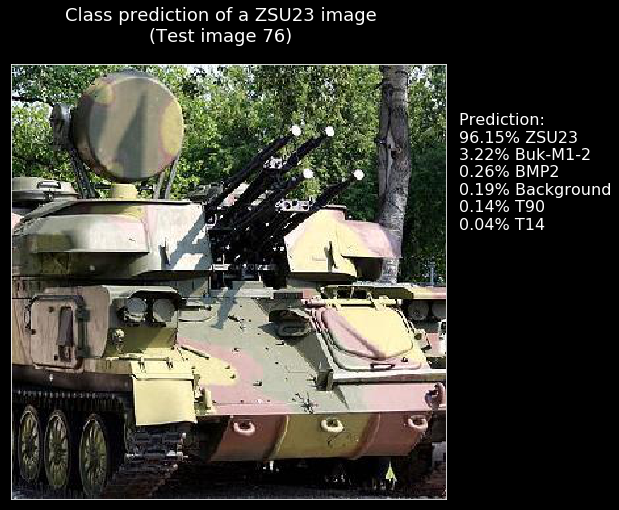

Image 77 : [(54.18, 'ZSU23'), (32.7, 'Buk-M1-2'), (7.22, 'T90'), (2.61, 'Background'), (2.03, 'BMP2'), (1.26, 'T14')] 



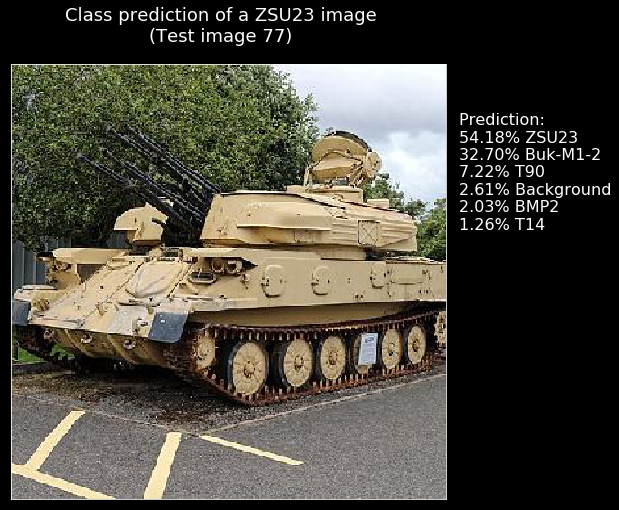

Image 78 : [(87.53, 'Buk-M1-2'), (3.94, 'T90'), (3.78, 'ZSU23'), (3.1, 'BMP2'), (1.23, 'Background'), (0.41, 'T14')] 



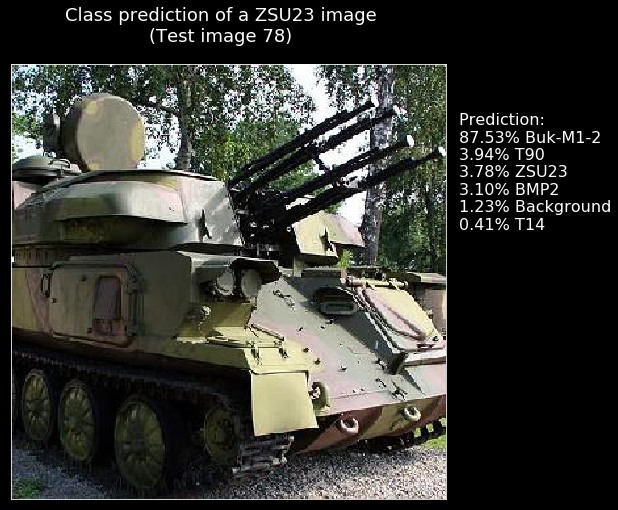

Image 79 : [(99.75, 'ZSU23'), (0.2, 'Buk-M1-2'), (0.03, 'Background'), (0.01, 'T90'), (0.01, 'BMP2'), (0.0, 'T14')] 



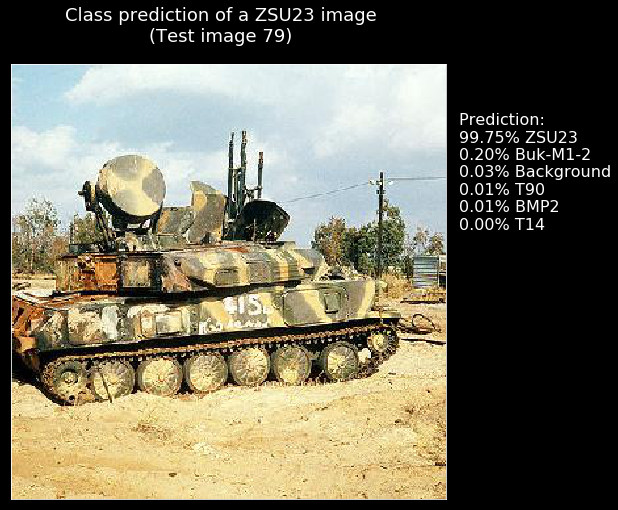

Image 80 : [(84.52, 'ZSU23'), (8.74, 'Buk-M1-2'), (4.07, 'BMP2'), (1.27, 'T90'), (0.95, 'Background'), (0.45, 'T14')] 



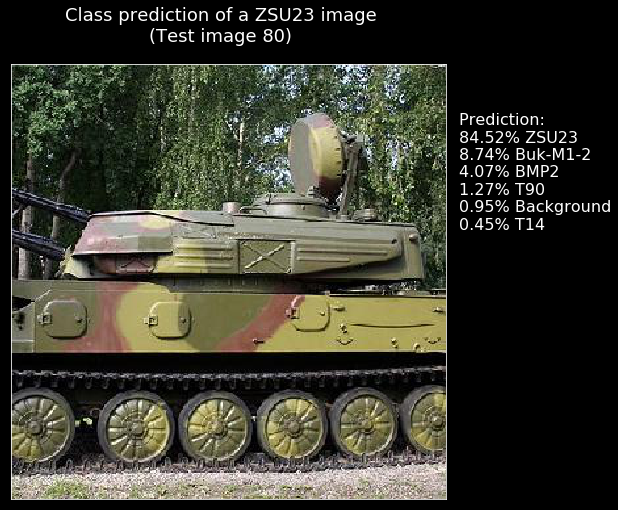

Image 81 : [(51.02, 'Buk-M1-2'), (47.39, 'ZSU23'), (0.74, 'Background'), (0.57, 'T90'), (0.25, 'BMP2'), (0.04, 'T14')] 



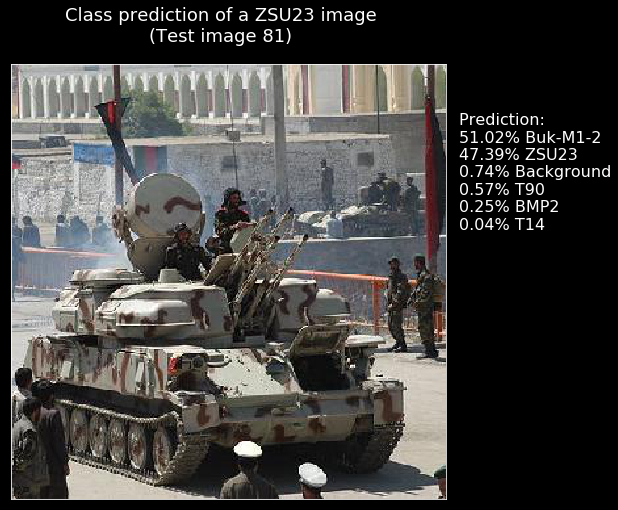

Image 82 : [(80.2, 'ZSU23'), (9.21, 'BMP2'), (4.42, 'Buk-M1-2'), (3.25, 'Background'), (1.83, 'T90'), (1.1, 'T14')] 



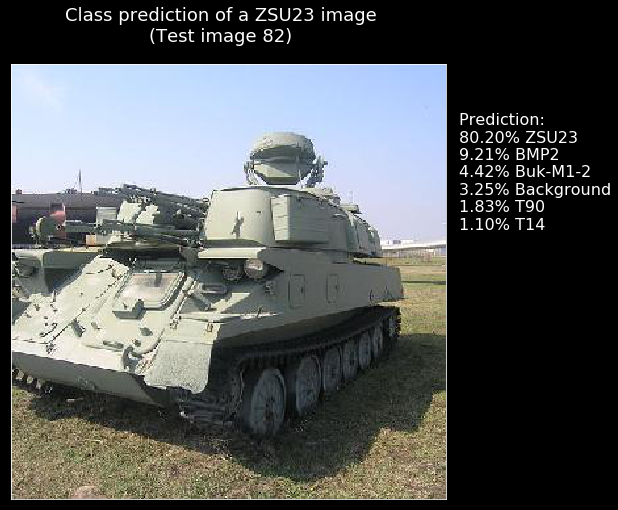

Image 83 : [(95.53, 'Buk-M1-2'), (2.0, 'T90'), (1.09, 'ZSU23'), (0.6, 'T14'), (0.49, 'BMP2'), (0.29, 'Background')] 



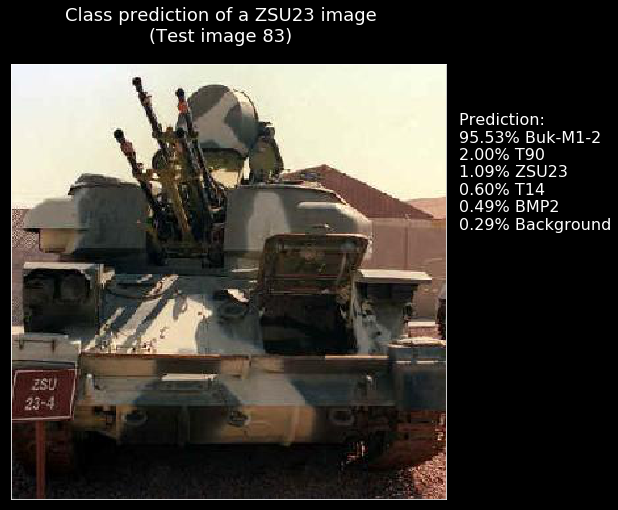

Image 84 : [(77.87, 'ZSU23'), (10.77, 'Buk-M1-2'), (4.34, 'Background'), (3.93, 'BMP2'), (1.55, 'T14'), (1.54, 'T90')] 



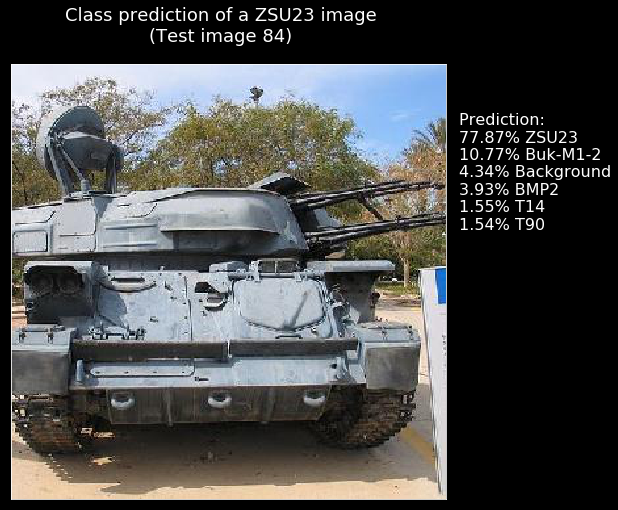

Image 85 : [(97.09, 'Buk-M1-2'), (1.25, 'BMP2'), (1.18, 'T90'), (0.21, 'T14'), (0.13, 'ZSU23'), (0.13, 'Background')] 



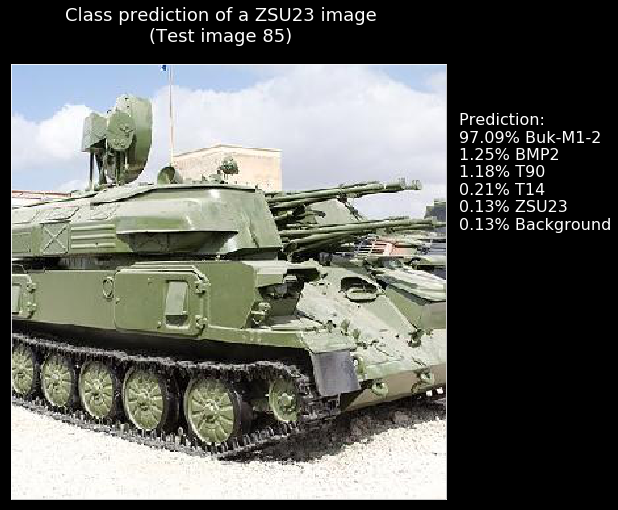

Image 86 : [(99.64, 'ZSU23'), (0.17, 'BMP2'), (0.06, 'Background'), (0.05, 'T90'), (0.04, 'T14'), (0.03, 'Buk-M1-2')] 



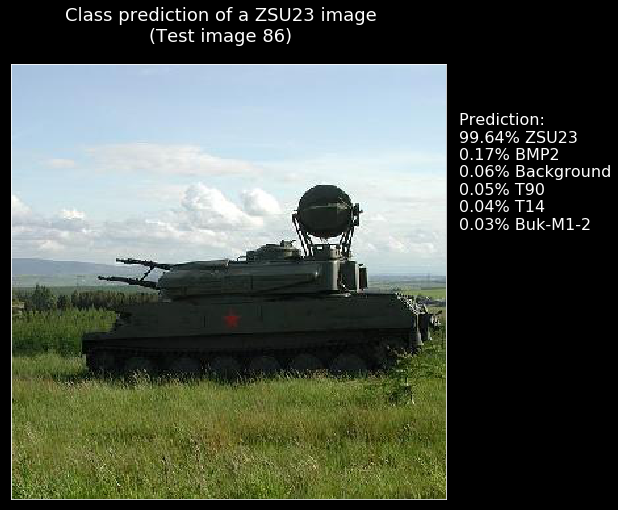

Image 87 : [(88.56, 'ZSU23'), (5.16, 'BMP2'), (4.58, 'Buk-M1-2'), (1.03, 'T90'), (0.5, 'Background'), (0.17, 'T14')] 



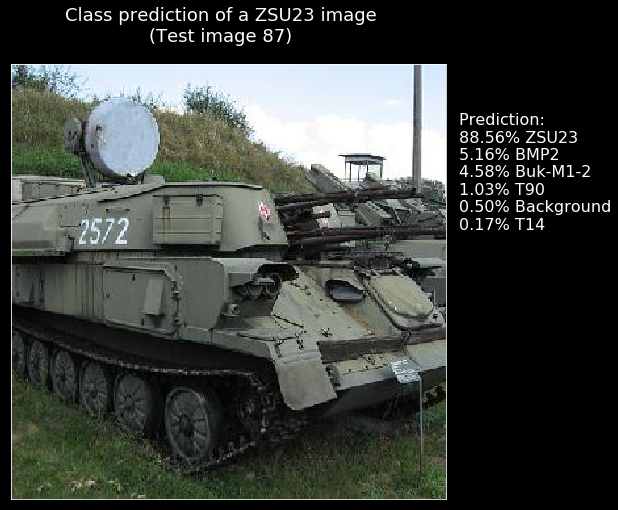

Image 88 : [(99.7, 'ZSU23'), (0.19, 'BMP2'), (0.05, 'Buk-M1-2'), (0.03, 'T90'), (0.02, 'Background'), (0.01, 'T14')] 



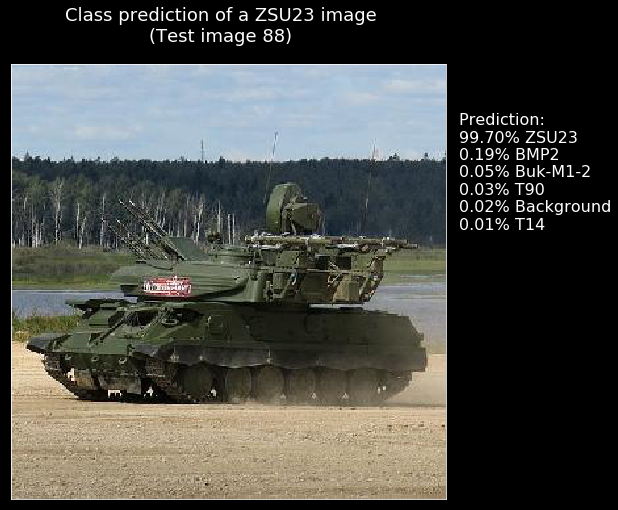

Image 89 : [(97.5, 'ZSU23'), (1.1, 'BMP2'), (0.96, 'T90'), (0.18, 'Buk-M1-2'), (0.14, 'T14'), (0.13, 'Background')] 



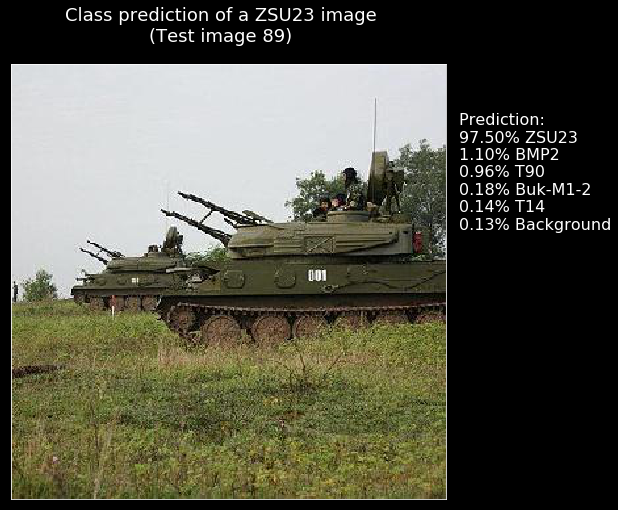

Image 90 : [(77.82, 'BMP2'), (16.6, 'ZSU23'), (3.76, 'T14'), (0.96, 'T90'), (0.56, 'Background'), (0.29, 'Buk-M1-2')] 



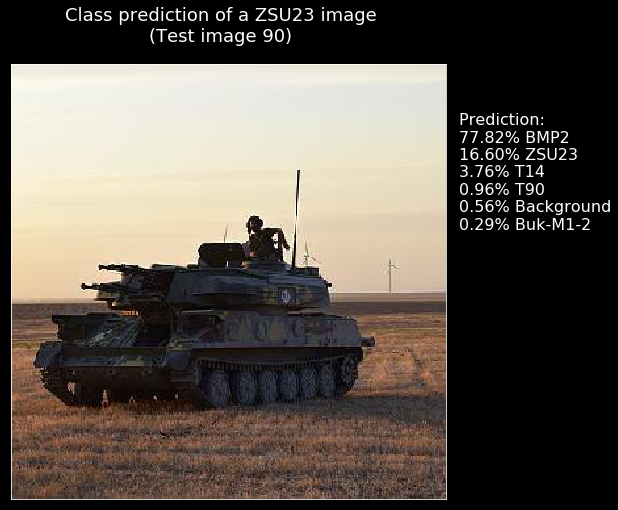

In [0]:
# plotting test images with class predictions as title
print("\nClass Predictions of test images from", dataset_path +'test/')
for k in range(len(test_images)):
    predictions = []
    for l in range(len(classnames)):
        predictions.append((np.round(pred[k][l] * 100, 2), classnames[l]))
    predictions.sort(reverse=True)
    print("Image", k + 1, ":", predictions,'\n')

    plt.figure(figsize=(8, 8))  # width, height in inches.
    plt.style.use('dark_background')
    plt.suptitle("Class prediction of a " + true_labels_class[k] + " image" + "\n(Test image " + str(k + 1) + ")", fontsize=18)
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    legend_string = "Prediction: " + \
                    "\n%.2f" % predictions[0][0] + "% " + predictions[0][1] + \
                    "\n%.2f" % predictions[1][0] + "% " + predictions[1][1] + \
                    "\n%.2f" % predictions[2][0] + "% " + predictions[2][1] + \
                    "\n%.2f" % predictions[3][0] + "% " + predictions[3][1] + \
                    "\n%.2f" % predictions[4][0] + "% " + predictions[4][1] + \
                    "\n%.2f" % predictions[5][0] + "% " + predictions[5][1]
    plt.text(img_width + 10, 125, legend_string, fontsize=16)
    plt.imshow(test_images[k])
    plt.show()